In [3]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

from __future__ import division
from __future__ import print_function
from __future__ import absolute_import
from __future__ import unicode_literals  

import math
import random
import copy
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn.linear_model as linear_model
import sklearn.preprocessing as preprocessing
import scipy
import scipy.linalg as slin
import scipy.sparse.linalg as sparselin
import scipy.sparse as sparse

sns.set(color_codes=True)

import sys
sys.path.append("C:/Tang/influence-release-master")  #设置自定义包的搜索路径
from load_vehicles_cover_testset import load_vehicles_cover_testset
from influence.image_utils import plot_flat_colorimage, plot_flat_colorgrad

Using TensorFlow backend.


In [4]:
num_classes = 2
num_train_ex_per_class = 1000
num_test_ex_per_class = 300

model_name = 'carair_%s_%s' % (num_train_ex_per_class, num_test_ex_per_class)
image_data_sets = load_vehicles_cover_testset(
    num_train_ex_per_class=num_train_ex_per_class, 
    num_test_ex_per_class=num_test_ex_per_class)

X_train = image_data_sets.train.x
X_test = image_data_sets.test.x
Y_train = image_data_sets.train.labels * 2 - 1
Y_test = image_data_sets.test.labels * 2 - 1

Loading vehicles from disk...


The test index now is 0. 
Test image:
-1.0 -0.1252167 0.9982337951660156


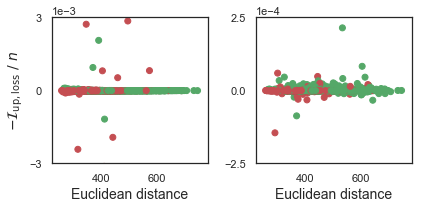

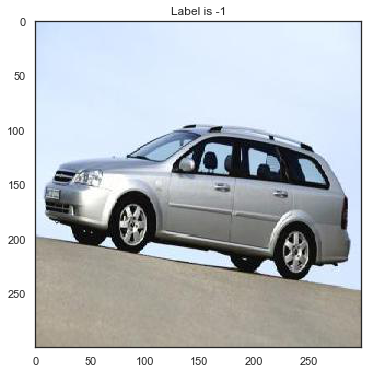

Top from Inception:
382 -1.0 323.04843 4.543989524245262e-05
1444 1.0 444.2765 4.76304404437542e-05
1681 1.0 298.7236 5.90391531586647e-05
1375 -1.0 606.21704 8.238376677036285e-05
887 -1.0 534.3892 0.00021417939662933349


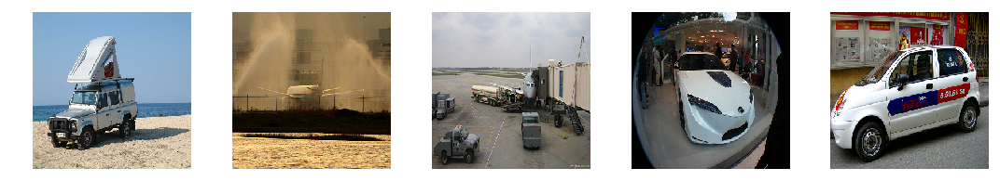

Last from Inception:
481 1.0 288.99875 -0.000145552396774292
1321 -1.0 367.77155 -8.741846680641174e-05
557 -1.0 644.795 -3.388116881251335e-05
698 1.0 405.37473 -3.2710619270801546e-05
902 1.0 373.11575 -3.0443843454122545e-05


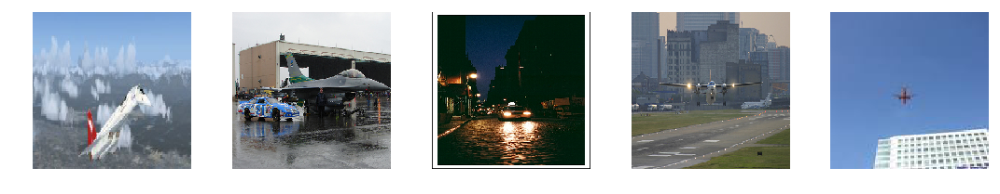

The test index now is 1. 
Test image:
-1.0 0.10862245 0.999250590801239


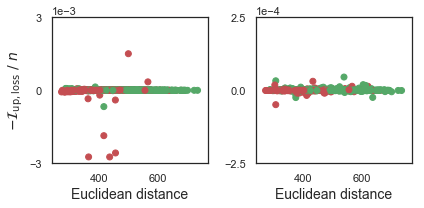

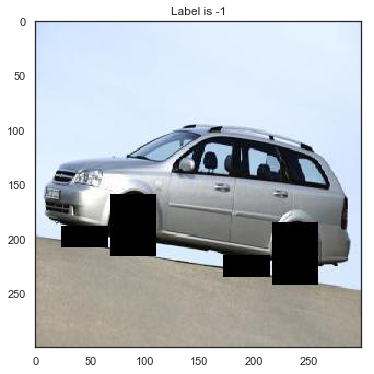

Top from Inception:
1681 1.0 301.01587 1.8479246646165847e-05
70 -1.0 605.9066 1.9487865269184114e-05
1444 1.0 432.36963 3.111590072512627e-05
1279 -1.0 304.31302 3.275549411773682e-05
887 -1.0 539.80444 4.558422788977623e-05


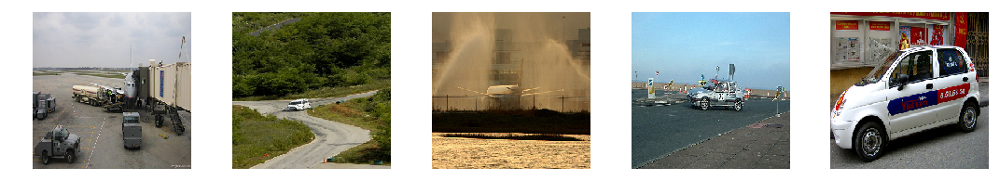

Last from Inception:
481 1.0 304.26416 -4.9020573496818545e-05
172 -1.0 373.47354 -2.4739827960729597e-05
557 -1.0 639.0029 -2.4245310574769975e-05
698 1.0 410.97726 -1.74010768532753e-05
591 -1.0 373.43112 -1.5391440130770207e-05


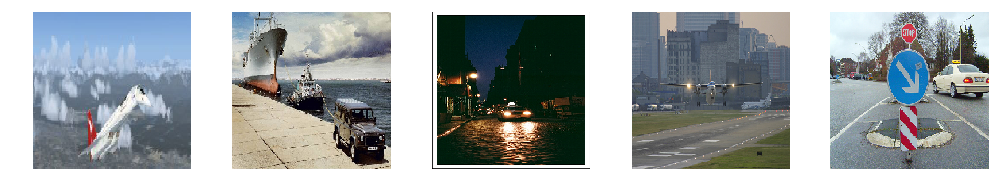

The test index now is 2. 
Test image:
-1.0 -0.03795816 0.9973728656768799


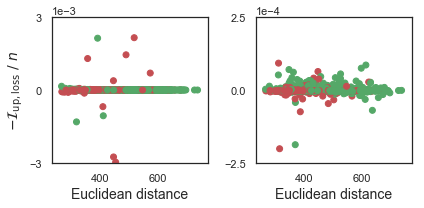

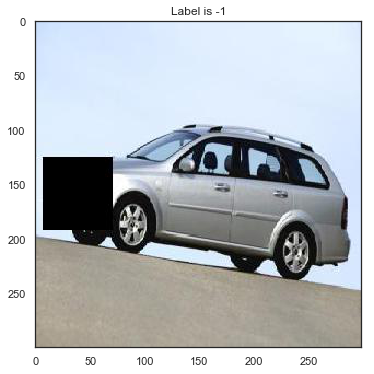

Top from Inception:
382 -1.0 347.86768 7.123859226703644e-05
1375 -1.0 597.4693 7.594123482704162e-05
1907 -1.0 613.3872 8.679646998643875e-05
1681 1.0 311.7943 9.324876219034195e-05
887 -1.0 552.8352 0.0003972923159599304


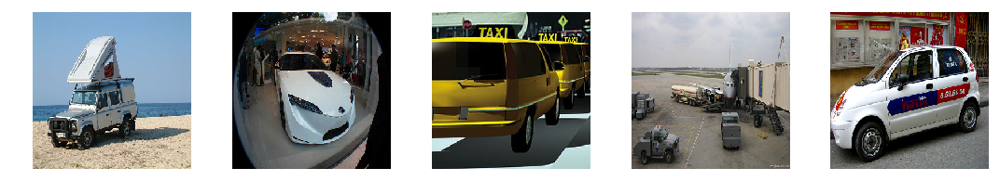

Last from Inception:
481 1.0 315.50046 -0.00020008754730224608
1321 -1.0 369.51346 -0.00018625602126121521
902 1.0 386.991 -7.340314239263535e-05
557 -1.0 635.87976 -6.847600638866424e-05
500 1.0 483.5823 -4.536137729883194e-05


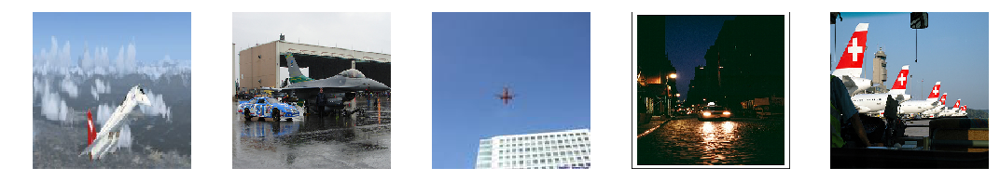

The test index now is 3. 
Test image:
-1.0 -0.123819456 0.9974623918533325


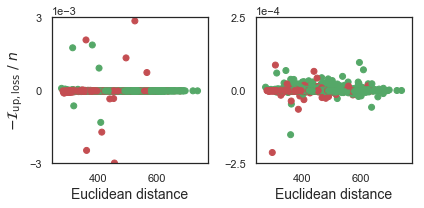

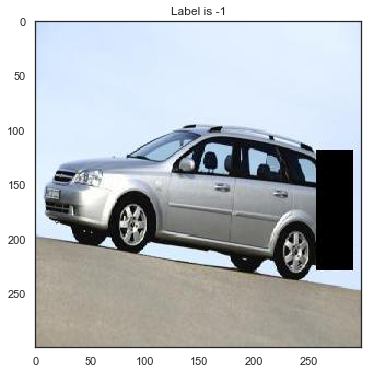

Top from Inception:
382 -1.0 345.1787 6.795711815357208e-05
1907 -1.0 609.98254 7.044392824172974e-05
1681 1.0 309.32184 8.663521707057953e-05
1375 -1.0 596.2438 9.559245407581329e-05
887 -1.0 535.58307 0.000349892258644104


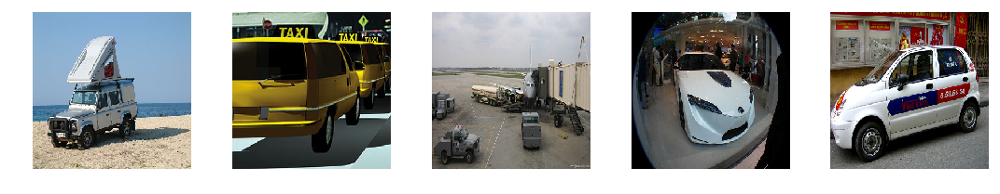

Last from Inception:
481 1.0 298.65994 -0.00021301521360874177
1321 -1.0 361.27505 -0.00015198388695716858
902 1.0 387.74005 -6.486322730779648e-05
557 -1.0 637.78046 -5.795753002166748e-05
172 -1.0 363.7641 -4.700112342834473e-05


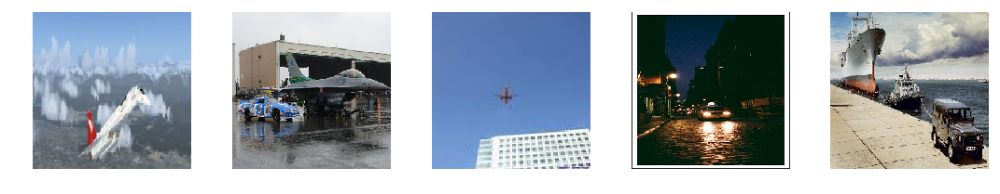

The test index now is 4. 
Test image:
-1.0 0.008988393 0.9996976852416992


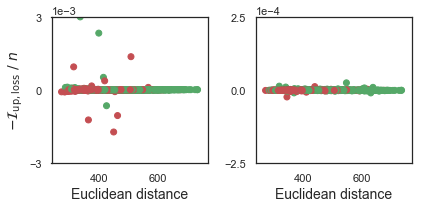

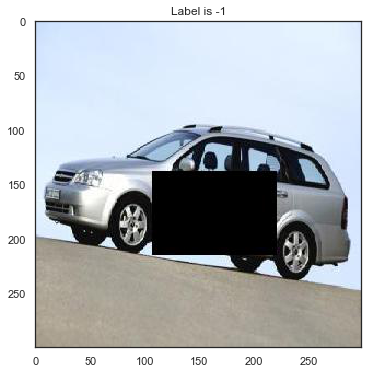

Top from Inception:
1375 -1.0 637.3995 1.0302003473043441e-05
382 -1.0 342.6695 1.1330746114253998e-05
1444 1.0 440.8522 1.2835471890866757e-05
1279 -1.0 320.8713 1.437699981033802e-05
887 -1.0 547.7354 2.574734017252922e-05


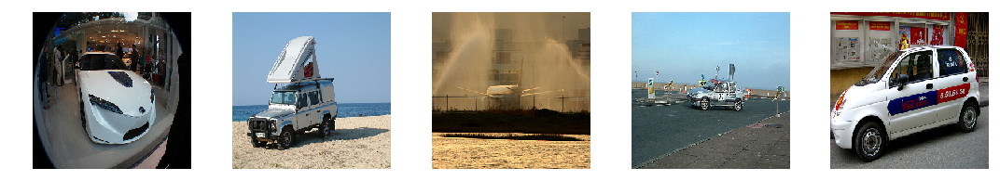

Last from Inception:
481 1.0 346.8057 -2.265273965895176e-05
557 -1.0 629.95844 -8.78496002405882e-06
172 -1.0 370.68716 -8.718254044651986e-06
698 1.0 412.24747 -6.2300190329551695e-06
984 1.0 379.935 -4.322302527725697e-06


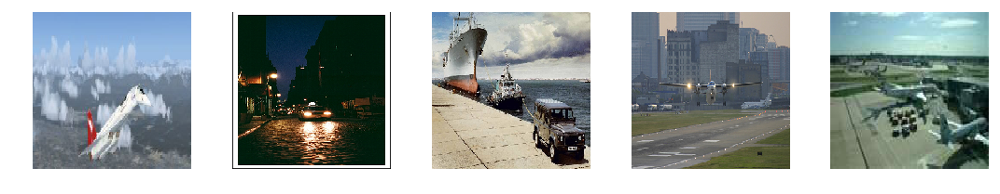

The test index now is 5. 
Test image:
-1.0 0.38143423 0.9972319006919861


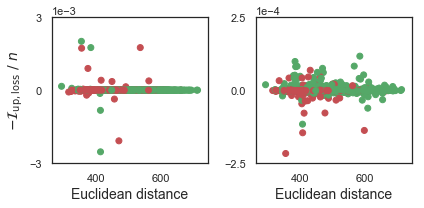

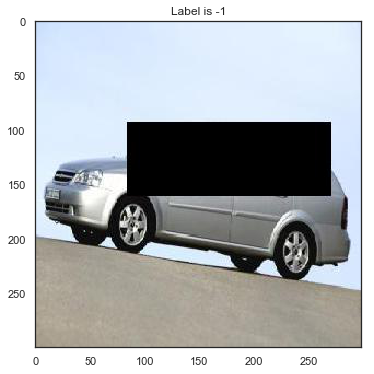

Top from Inception:
591 -1.0 384.96362 8.119364827871323e-05
1076 -1.0 389.31638 8.25510174036026e-05
70 -1.0 565.95233 8.306708931922912e-05
1279 -1.0 383.1102 9.898441284894943e-05
1907 -1.0 583.2739 0.00011720554530620575


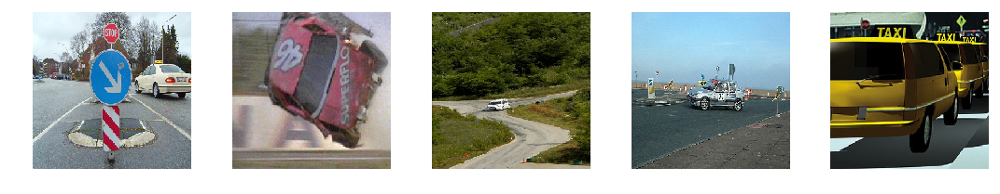

Last from Inception:
1681 1.0 354.13885 -0.00021637462079524995
902 1.0 406.61237 -0.00014540375769138335
1167 1.0 597.20905 -0.0001373438388109207
172 -1.0 406.1749 -0.00011588741838932038
783 1.0 411.0338 -7.813762128353119e-05


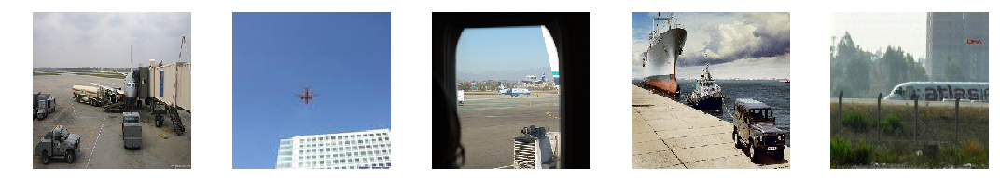

The test index now is 6. 
Test image:
-1.0 0.416775 0.997593343257904


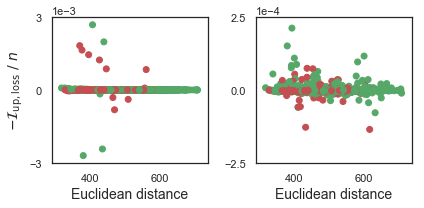

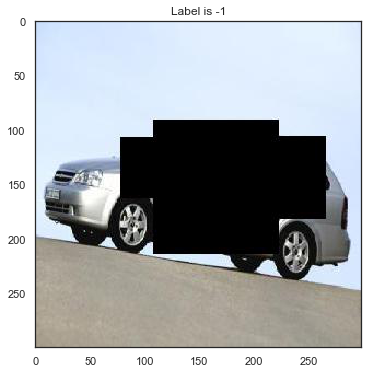

Top from Inception:
1907 -1.0 582.00604 9.736666828393937e-05
1076 -1.0 399.97696 0.00011046624183654785
557 -1.0 600.53375 0.00011751352250576019
1279 -1.0 379.60403 0.0001522739827632904
578 -1.0 393.04312 0.00021328233182430268


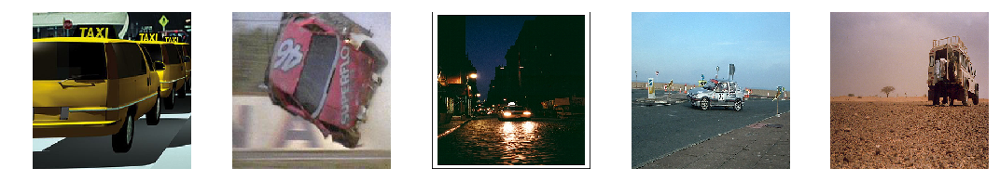

Last from Inception:
1681 1.0 349.24084 -0.00040860036015510557
1167 1.0 616.7036 -0.00013394795358181
902 1.0 432.3929 -0.00012640480697154998
1375 -1.0 632.3965 -7.679960131645203e-05
958 1.0 411.03152 -5.780286341905594e-05


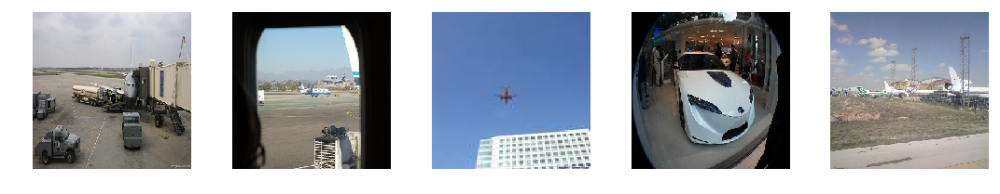

The test index now is 7. 
Test image:
1.0 1.3781374 0.9994304776191711


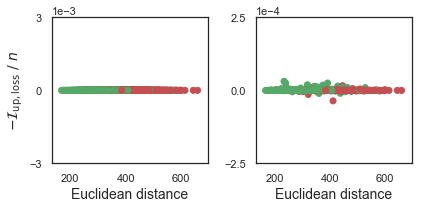

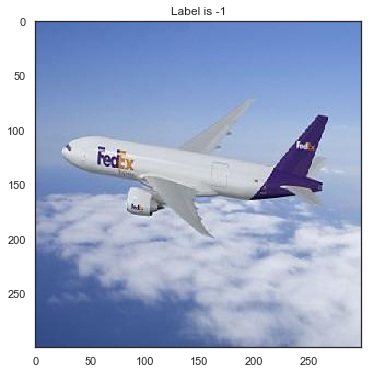

Top from Inception:
167 1.0 375.54538 1.8006253987550735e-05
1824 1.0 319.34677 1.9133877009153367e-05
1116 1.0 392.2001 2.50877533107996e-05
1853 1.0 240.25865 2.5719918310642242e-05
481 1.0 234.7025 3.07479053735733e-05


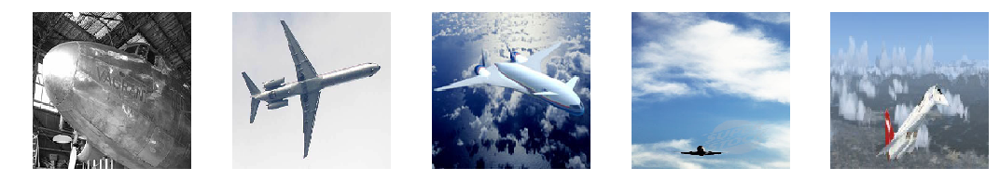

Last from Inception:
1321 -1.0 411.85748 -3.6113210022449496e-05
591 -1.0 321.92667 -1.4220263808965683e-05
75 1.0 360.78824 -1.0610135272145272e-05
1444 1.0 438.43692 -1.0151647962629795e-05
1633 1.0 264.4684 -5.1367050036787986e-06


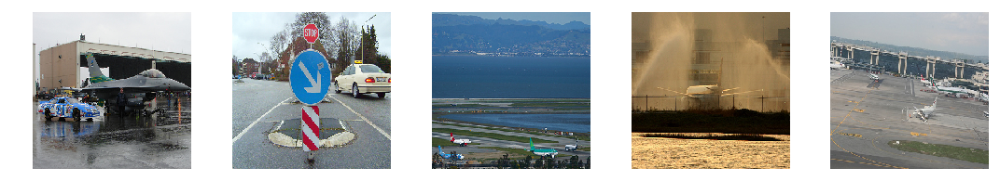

The test index now is 8. 
Test image:
1.0 0.9707123 0.9977703094482422


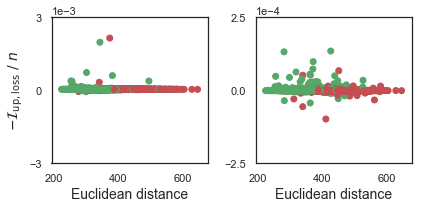

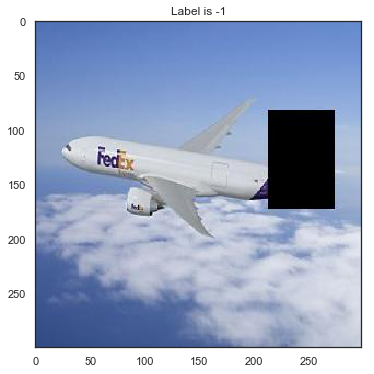

Top from Inception:
887 -1.0 450.90854 6.726662069559097e-05
1824 1.0 370.5825 7.316800951957702e-05
167 1.0 371.38757 9.839078783988953e-05
481 1.0 281.08167 0.00013208553194999696
1116 1.0 426.02005 0.0001347324252128601


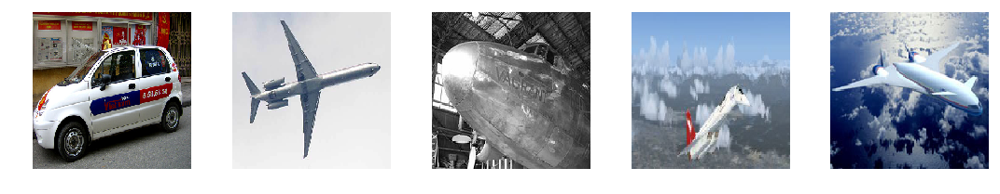

Last from Inception:
1321 -1.0 410.91385 -9.825263917446136e-05
591 -1.0 339.13782 -5.6011021137237546e-05
75 1.0 362.26474 -4.330625757575035e-05
1633 1.0 281.9896 -3.53911891579628e-05
557 -1.0 561.6131 -3.28868106007576e-05


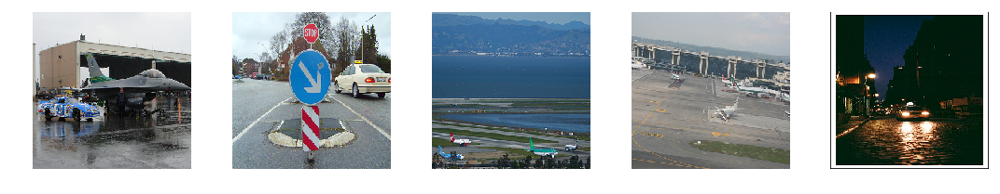

The test index now is 9. 
Test image:
1.0 0.8762091 0.9986248016357422


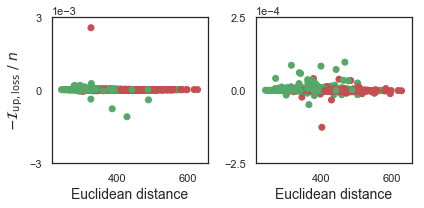

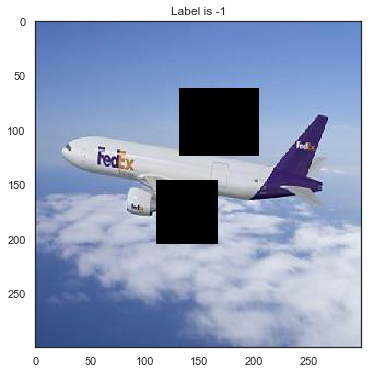

Top from Inception:
698 1.0 337.27496 6.0561265796422956e-05
1116 1.0 442.07288 7.147751748561859e-05
167 1.0 398.96036 8.308982849121094e-05
481 1.0 314.7081 8.588126301765442e-05
500 1.0 467.02917 9.659625589847565e-05


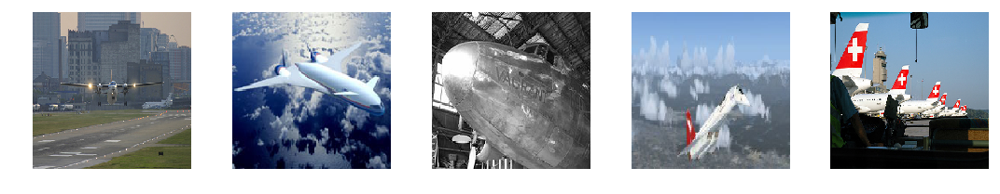

Last from Inception:
1321 -1.0 401.5691 -0.00012647396326065063
75 1.0 364.62567 -4.887577146291733e-05
1941 -1.0 428.81165 -3.307246044278145e-05
591 -1.0 344.72214 -2.3220399394631386e-05
1707 1.0 380.04288 -1.7778530716896057e-05


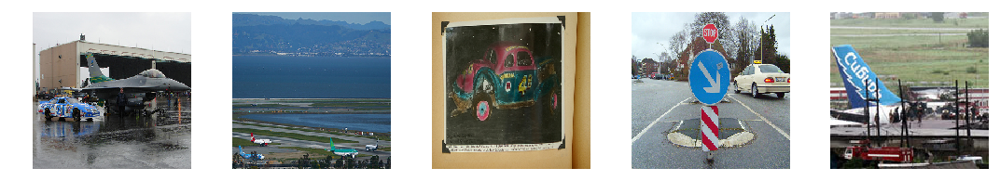

The test index now is 10. 
Test image:
1.0 1.2181357 0.9984312653541565


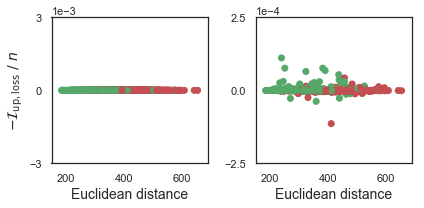

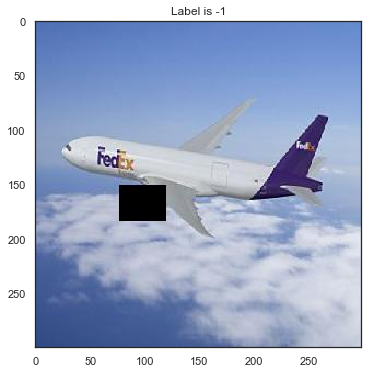

Top from Inception:
1824 1.0 324.6521 6.470530480146408e-05
1116 1.0 390.89163 6.774811446666717e-05
1853 1.0 252.27603 7.595640420913696e-05
167 1.0 382.6707 7.598941773176194e-05
481 1.0 240.67671 0.00011117354035377502


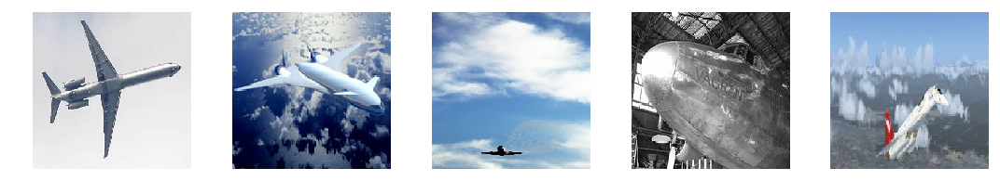

Last from Inception:
1321 -1.0 411.80743 -0.00011400707066059113
75 1.0 359.89166 -3.774867951869965e-05
1633 1.0 271.46738 -2.7418671175837517e-05
1444 1.0 439.9629 -2.695254981517792e-05
591 -1.0 331.9399 -2.4594252929091454e-05


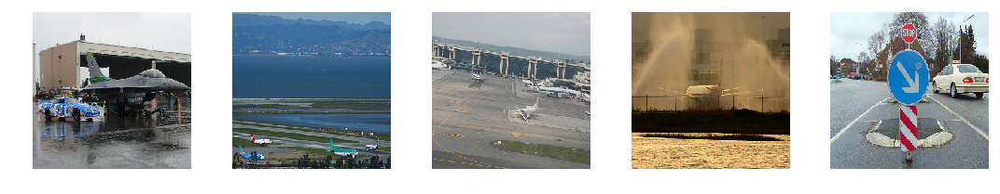

The test index now is 11. 
Test image:
1.0 1.1935043 0.9967814683914185


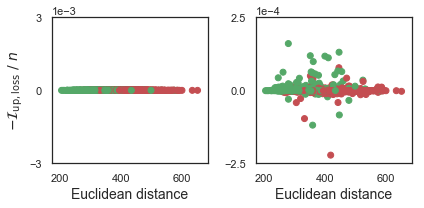

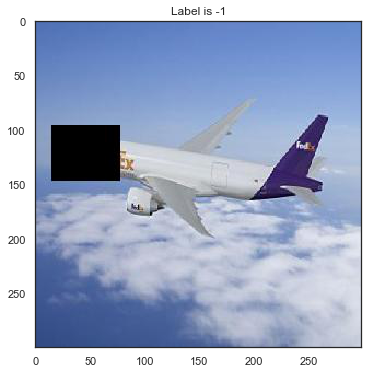

Top from Inception:
1116 1.0 399.16412 0.00011726431548595429
1824 1.0 351.222 0.0001187305748462677
500 1.0 445.76175 0.00013068175315856934
1853 1.0 279.0846 0.00016033799946308137
481 1.0 269.73358 0.0002599424719810486


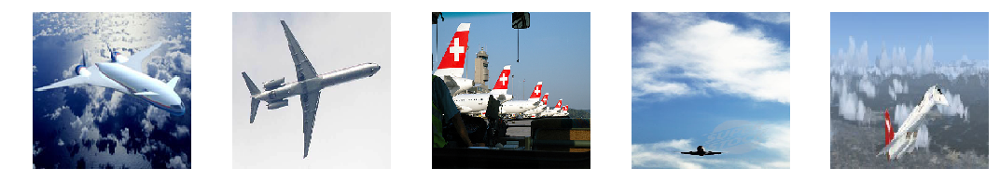

Last from Inception:
1321 -1.0 418.22775 -0.0002219995856285095
75 1.0 358.96503 -0.0001192496046423912
591 -1.0 332.19336 -9.676392376422882e-05
1444 1.0 446.59882 -8.436495065689088e-05
1076 -1.0 305.29886 -4.205977916717529e-05


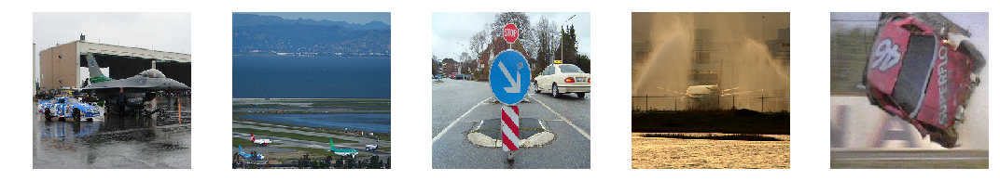

The test index now is 12. 
Test image:
1.0 1.2812725 0.9997703433036804


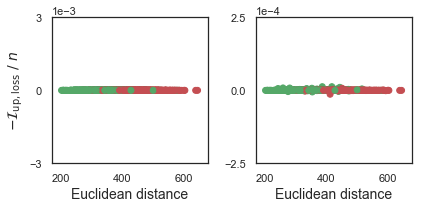

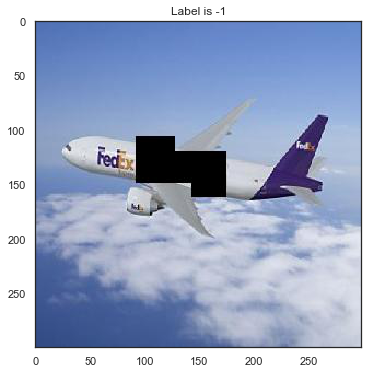

Top from Inception:
1853 1.0 280.6087 7.969122380018235e-06
481 1.0 258.73605 8.247571997344495e-06
500 1.0 443.8003 1.0306315496563912e-05
167 1.0 386.70712 1.2542907148599624e-05
1116 1.0 417.9408 1.2585686519742012e-05


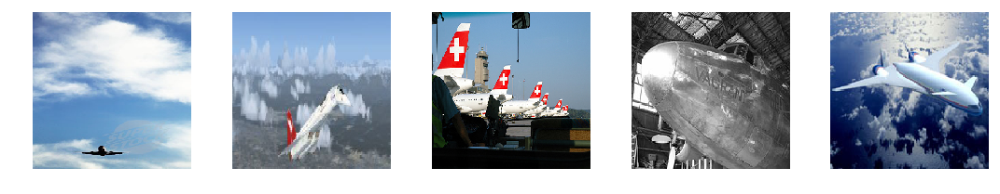

Last from Inception:
1321 -1.0 412.22214 -1.3254692777991295e-05
75 1.0 354.28894 -5.4409140720963475e-06
1633 1.0 275.19775 -4.159803502261639e-06
1444 1.0 439.99756 -3.574690781533718e-06
591 -1.0 330.2239 -2.7045407332479955e-06


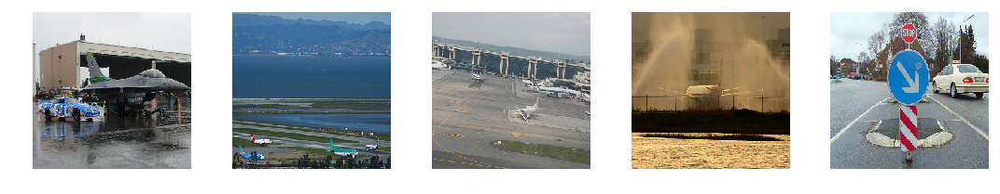

The test index now is 13. 
Test image:
1.0 -0.07957274 0.9998891353607178


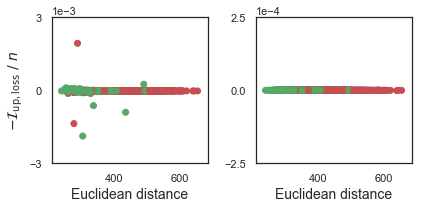

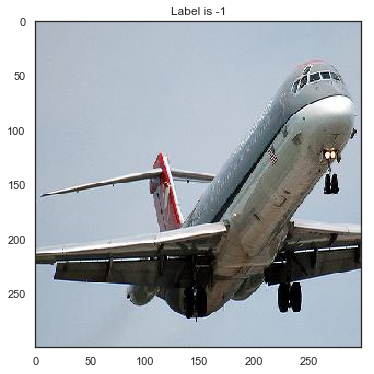

Top from Inception:
1279 -1.0 304.94342 1.7508133314549922e-06
167 1.0 412.3979 1.8433913355693222e-06
1666 1.0 419.49634 1.9922414794564245e-06
1116 1.0 375.24796 2.2453528363257648e-06
1632 1.0 398.25394 2.2935387678444388e-06


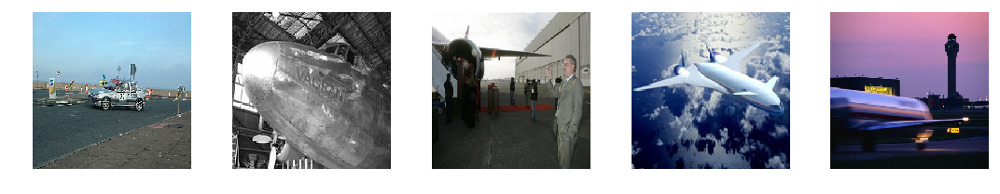

Last from Inception:
481 1.0 285.74698 -1.231965608894825e-06
698 1.0 351.3682 -1.1562159052118658e-06
75 1.0 378.29947 -1.1164345778524876e-06
852 1.0 544.92914 -1.0856306180357932e-06
1853 1.0 313.59735 -1.0237167589366436e-06


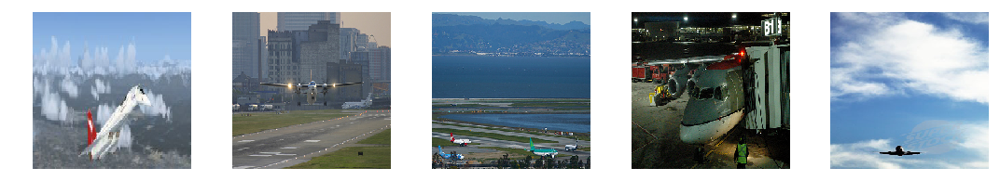

The test index now is 14. 
Test image:
1.0 -0.32838696 0.9999275207519531


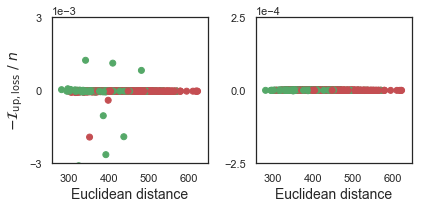

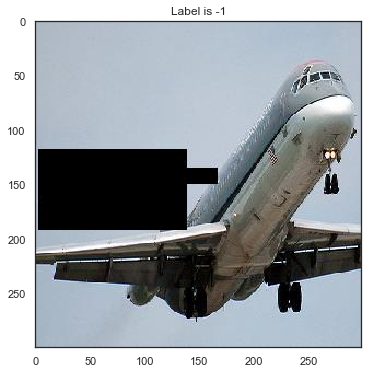

Top from Inception:
935 1.0 365.10892 1.1625668266788125e-06
172 -1.0 383.47876 1.204149564728141e-06
167 1.0 467.02853 1.297598355449736e-06
1632 1.0 411.1463 1.4390568248927594e-06
1321 -1.0 342.665 2.8629242442548273e-06


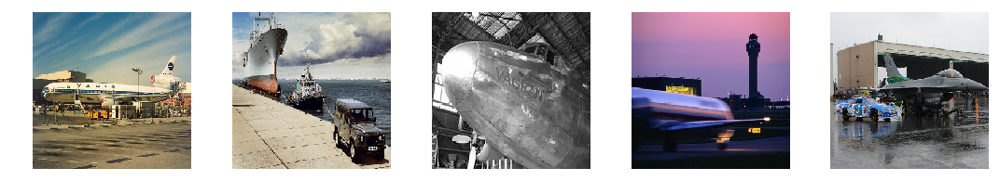

Last from Inception:
481 1.0 350.16733 -1.9811033271253108e-06
1853 1.0 387.45953 -1.122201676480472e-06
698 1.0 350.55835 -8.785072714090347e-07
578 -1.0 347.19864 -7.390863611362874e-07
1094 1.0 354.34137 -7.309684297069907e-07


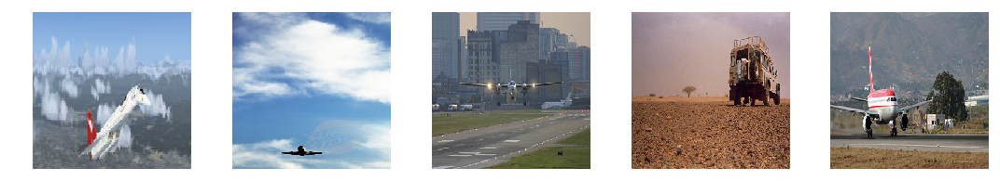

The test index now is 15. 
Test image:
1.0 0.29271436 0.9997504353523254


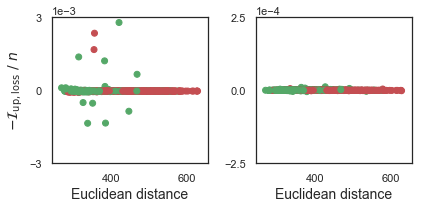

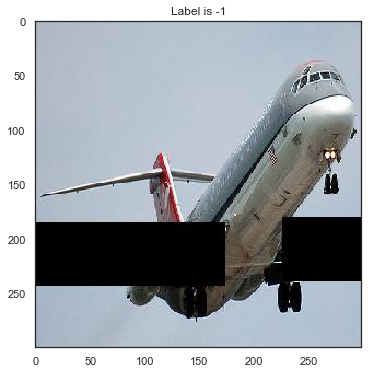

Top from Inception:
1321 -1.0 333.88046 6.0498681850731375e-06
1167 1.0 490.4157 6.5692942589521405e-06
1632 1.0 373.15558 7.827315479516983e-06
1116 1.0 363.18323 1.0289639234542846e-05
167 1.0 426.5526 1.2168925255537033e-05


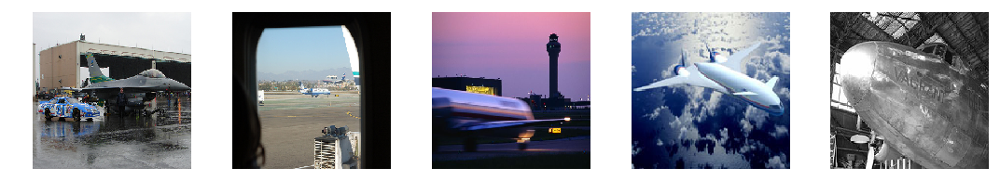

Last from Inception:
75 1.0 377.7978 -4.380513913929463e-06
1633 1.0 340.66724 -3.7579932250082494e-06
852 1.0 534.8879 -3.243274986743927e-06
481 1.0 333.32724 -2.1984525956213473e-06
698 1.0 361.90198 -2.0387950353324415e-06


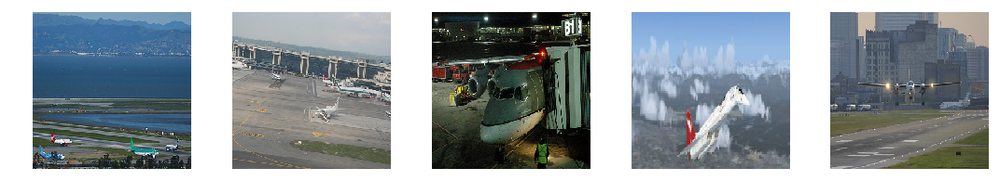

The test index now is 16. 
Test image:
1.0 -0.20464605 0.9998986721038818


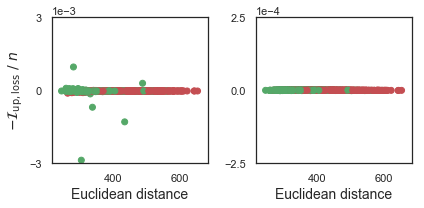

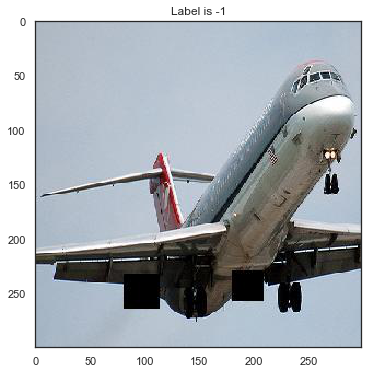

Top from Inception:
1666 1.0 418.0855 1.3902757782489062e-06
167 1.0 416.18253 1.9599522929638625e-06
1681 1.0 304.21838 2.055948134511709e-06
1632 1.0 396.0594 2.462442731484771e-06
1116 1.0 373.51556 2.4638953618705274e-06


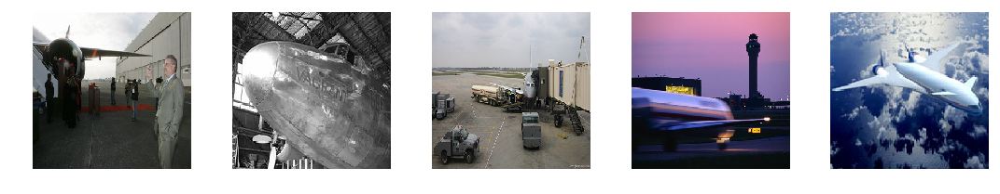

Last from Inception:
481 1.0 290.00555 -1.2210755376145245e-06
1167 1.0 502.99924 -1.13503634929657e-06
75 1.0 380.6589 -9.181125788018107e-07
698 1.0 355.10846 -8.912825724110008e-07
852 1.0 542.9751 -8.541317074559628e-07


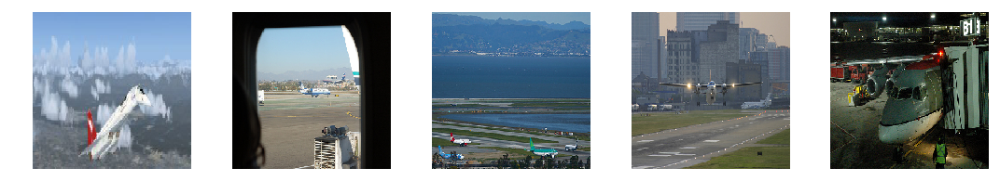

The test index now is 17. 
Test image:
1.0 -0.33954388 0.9996874332427979


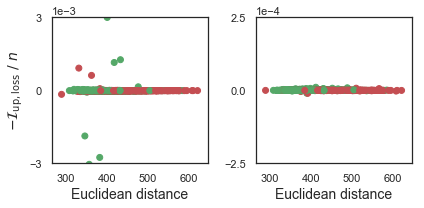

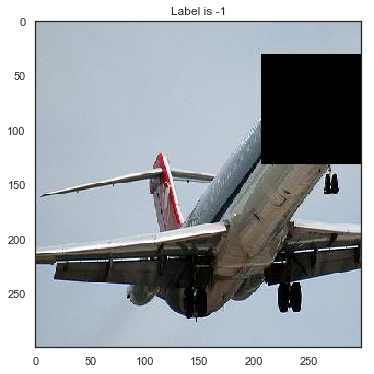

Top from Inception:
567 1.0 398.33136 6.790340878069401e-06
1666 1.0 452.11676 7.275376468896866e-06
1375 -1.0 510.21628 7.339067291468382e-06
1167 1.0 488.62952 8.77829734236002e-06
1654 1.0 411.77737 1.0555261746048927e-05


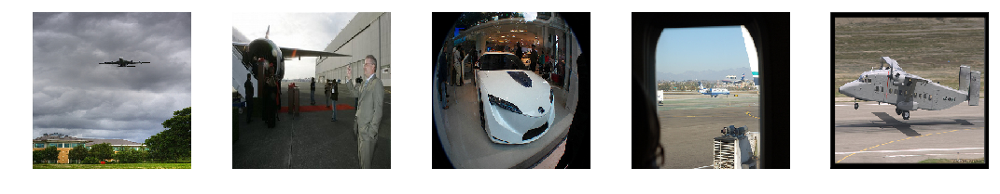

Last from Inception:
1321 -1.0 392.08728 -1.0215110145509243e-05
75 1.0 389.76398 -9.773243218660355e-06
1076 -1.0 375.1003 -4.042410291731358e-06
1633 1.0 354.14832 -2.51065194606781e-06
469 -1.0 607.46783 -2.4765441194176673e-06


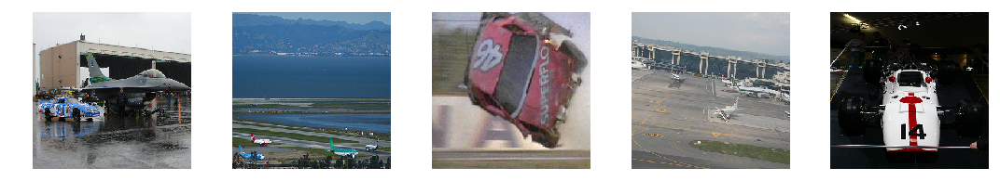

The test index now is 18. 
Test image:
1.0 -0.31545794 0.9987809062004089


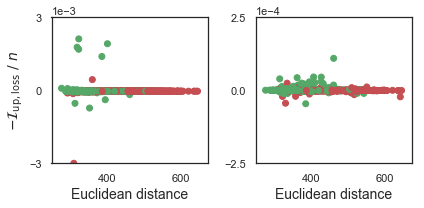

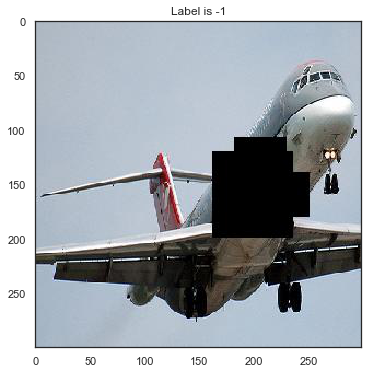

Top from Inception:
958 1.0 312.88577 3.944693133234978e-05
698 1.0 360.6482 4.3472565710544584e-05
167 1.0 426.89386 4.550067335367203e-05
1116 1.0 405.8402 4.575739800930023e-05
500 1.0 460.88358 0.00010973453521728515


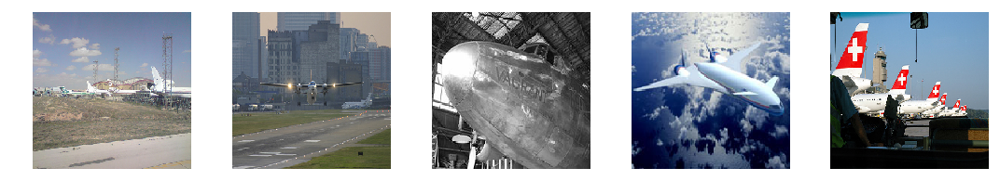

Last from Inception:
75 1.0 384.21268 -4.595333710312843e-05
1321 -1.0 328.83292 -4.406681656837463e-05
469 -1.0 643.70953 -2.216794341802597e-05
578 -1.0 320.5888 -2.0950300619006157e-05
1076 -1.0 356.42126 -2.0399544388055802e-05


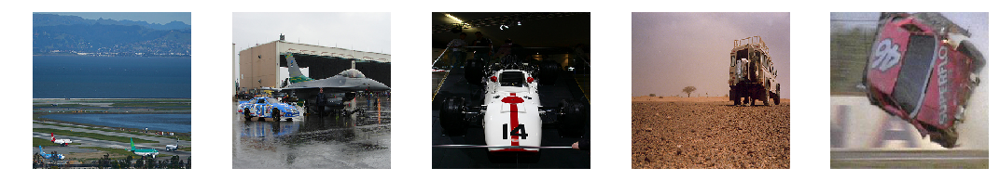

The test index now is 19. 
Test image:
-1.0 0.25716013 0.9977304339408875


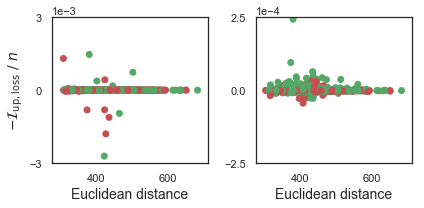

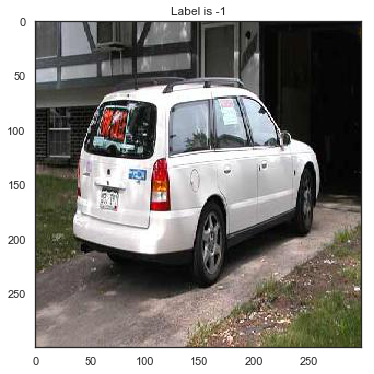

Top from Inception:
1519 -1.0 390.42392 4.667183756828308e-05
591 -1.0 437.45047 4.954402148723602e-05
1907 -1.0 436.08914 6.397050619125367e-05
1375 -1.0 375.29803 9.532314538955689e-05
887 -1.0 381.5492 0.0002438693195581436


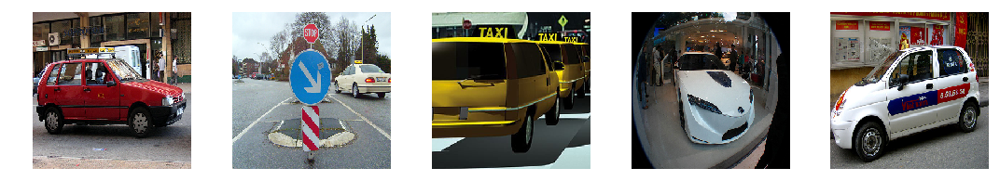

Last from Inception:
783 1.0 409.48343 -4.377482086420059e-05
902 1.0 398.6315 -2.7661921456456183e-05
172 -1.0 437.2492 -2.746836096048355e-05
1 1.0 416.16492 -2.700040116906166e-05
984 1.0 409.6667 -2.6760686188936233e-05


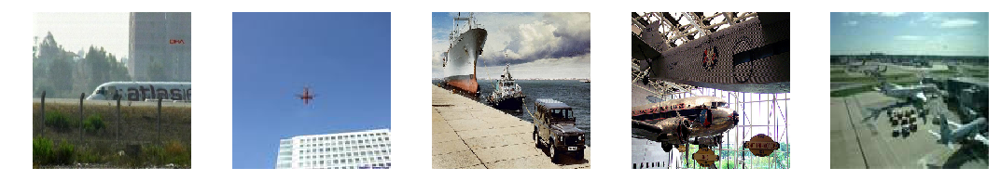

The test index now is 20. 
Test image:
-1.0 0.25187898 0.9986175298690796


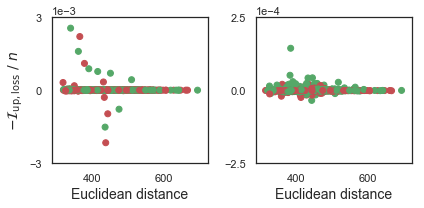

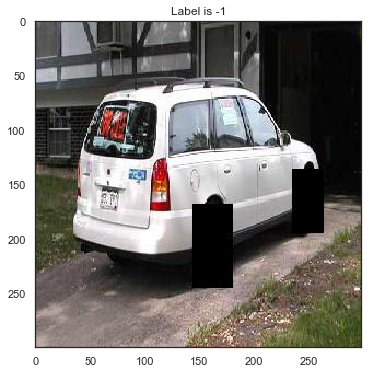

Top from Inception:
1519 -1.0 390.094 2.989487908780575e-05
1907 -1.0 432.56955 4.238498955965042e-05
591 -1.0 445.14786 4.297282546758652e-05
1375 -1.0 382.0803 5.1701098680496214e-05
887 -1.0 383.9368 0.000144276961684227


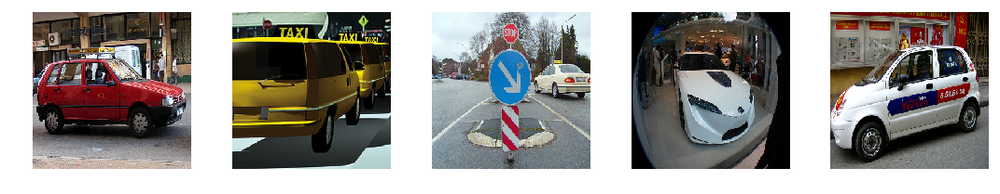

Last from Inception:
172 -1.0 443.03314 -3.4424889832735065e-05
783 1.0 412.79367 -2.4361148476600646e-05
698 1.0 357.82187 -2.0085804164409638e-05
984 1.0 412.3354 -1.7567040398716927e-05
1116 1.0 443.83215 -1.6410598531365394e-05


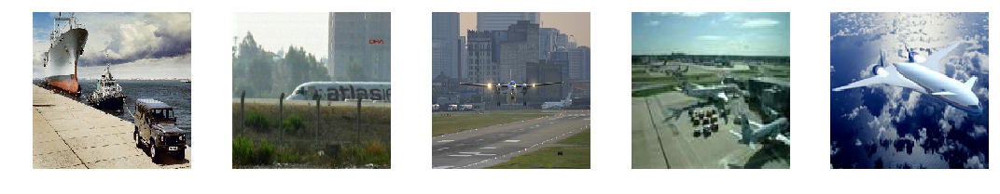

The test index now is 21. 
Test image:
-1.0 0.28254578 0.9954618811607361


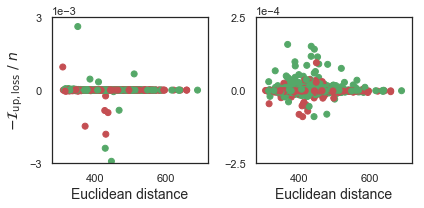

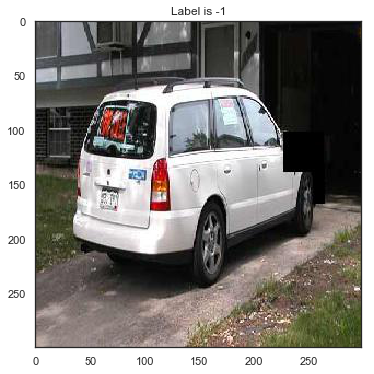

Top from Inception:
382 -1.0 434.85062 0.00011675958335399628
591 -1.0 443.93076 0.00014104506373405456
1907 -1.0 435.15662 0.00015104322135448456
1375 -1.0 368.5926 0.00015743178129196166
887 -1.0 384.18436 0.000528748869895935


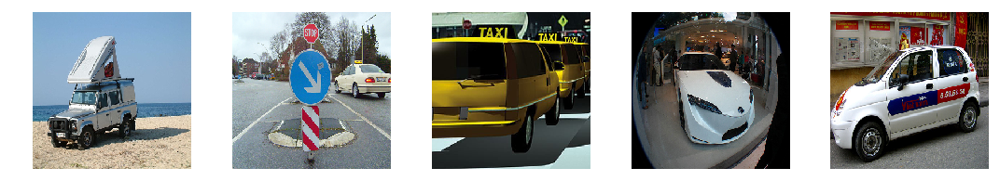

Last from Inception:
783 1.0 410.88086 -9.019236266613007e-05
172 -1.0 443.04742 -9.004579484462738e-05
902 1.0 400.833 -8.231911063194274e-05
1321 -1.0 479.06784 -8.171122521162033e-05
481 1.0 425.2151 -7.118113338947296e-05


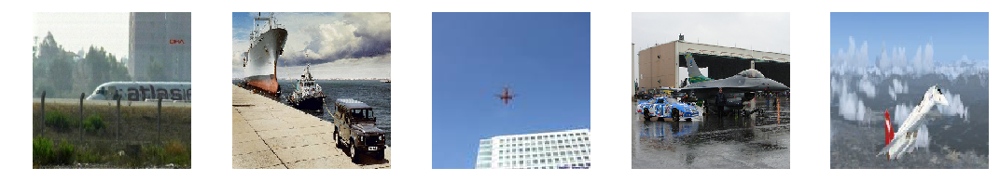

The test index now is 22. 
Test image:
-1.0 0.7439343 0.998369038105011


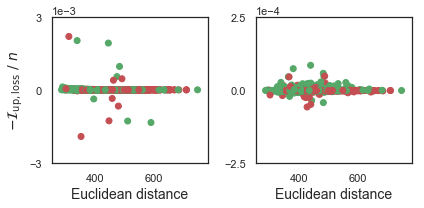

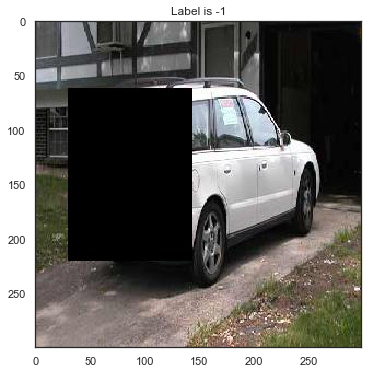

Top from Inception:
591 -1.0 485.9613 4.805877059698105e-05
1681 1.0 488.6676 4.876510426402092e-05
1279 -1.0 483.92258 5.843233317136764e-05
1907 -1.0 381.42325 7.435877621173858e-05
887 -1.0 440.70514 8.592905104160308e-05


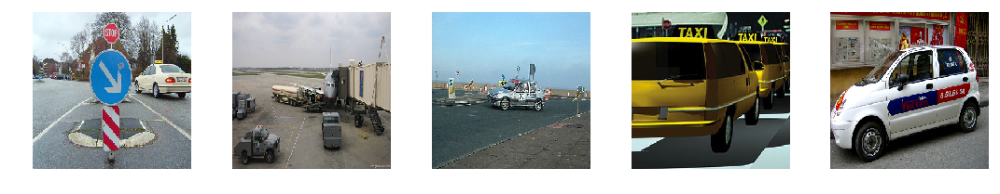

Last from Inception:
783 1.0 428.69836 -5.7004179805517194e-05
902 1.0 441.4376 -4.816380515694618e-05
1321 -1.0 484.1375 -4.213879629969597e-05
557 -1.0 444.40002 -3.476263955235481e-05
984 1.0 424.86624 -2.4866096675395966e-05


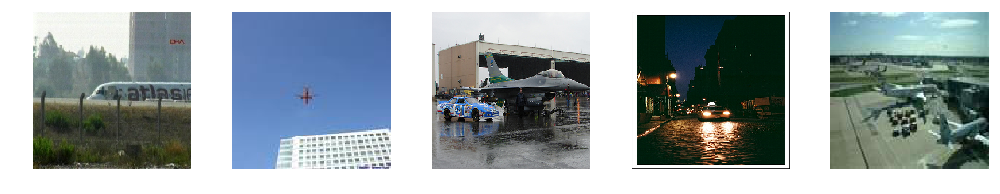

The test index now is 23. 
Test image:
-1.0 0.16330034 0.9890748858451843


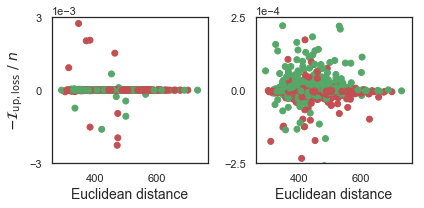

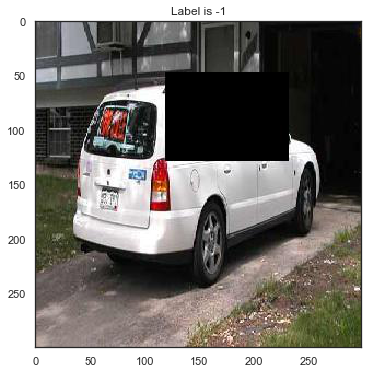

Top from Inception:
1375 -1.0 348.0167 0.00022147576510906218
481 1.0 469.95486 0.00041066694259643554
591 -1.0 448.697 0.0005387557744979858
1907 -1.0 393.92737 0.0005900784134864807
887 -1.0 377.5884 0.0008696050643920898


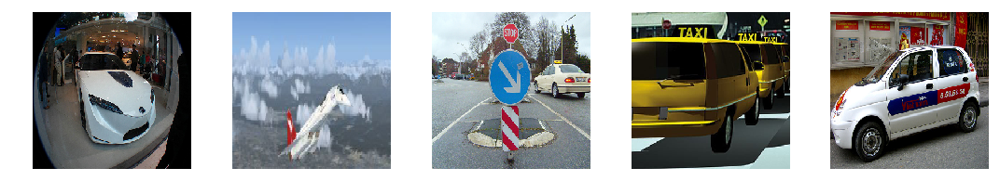

Last from Inception:
783 1.0 446.00784 -0.0003740888237953186
1681 1.0 487.07285 -0.00036912071704864503
172 -1.0 482.7389 -0.00025790375471115113
958 1.0 409.41394 -0.00023326791822910308
1992 1.0 309.47772 -0.00017479318380355836


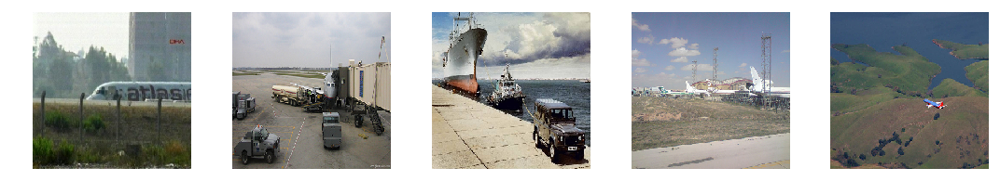

The test index now is 24. 
Test image:
-1.0 0.3969884 0.9982317090034485


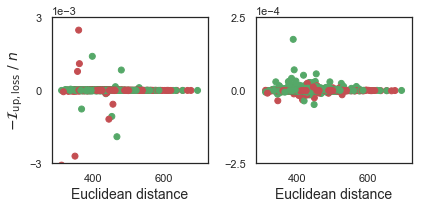

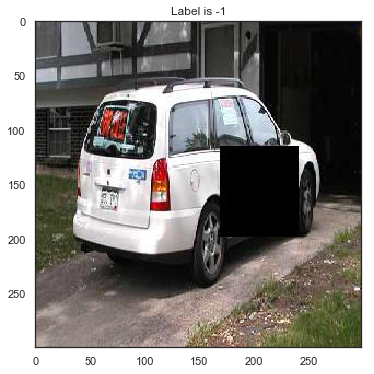

Top from Inception:
1519 -1.0 384.59683 4.1242111474275587e-05
1907 -1.0 418.4773 5.1776397973299023e-05
591 -1.0 454.48438 5.655690655112267e-05
1375 -1.0 392.0718 7.033248990774155e-05
887 -1.0 389.32404 0.0001747734546661377


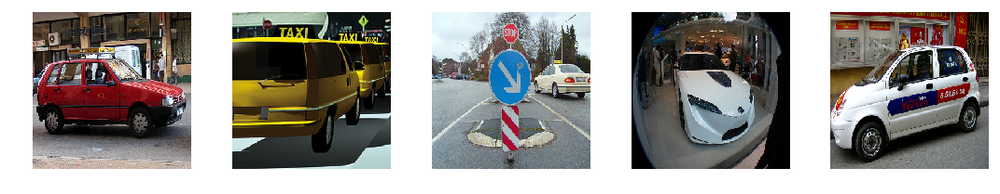

Last from Inception:
172 -1.0 448.4858 -4.866093397140503e-05
1171 -1.0 420.19888 -3.6159299314022065e-05
698 1.0 345.69962 -3.558853268623352e-05
783 1.0 415.8189 -3.263271972537041e-05
902 1.0 414.71143 -2.691408060491085e-05


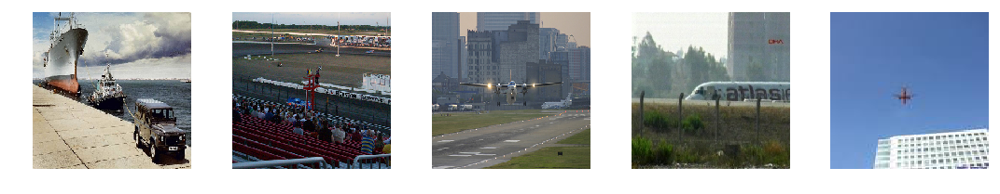

The test index now is 25. 
Test image:
-1.0 0.30819592 0.9938212037086487


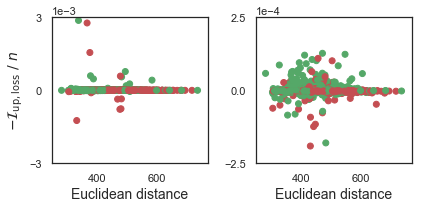

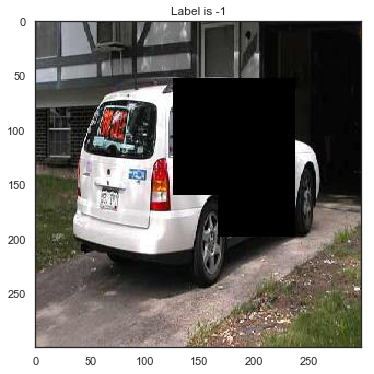

Top from Inception:
382 -1.0 472.15836 0.00012700271606445312
481 1.0 491.8558 0.0002597654163837433
591 -1.0 464.95554 0.0002830924689769745
1907 -1.0 377.15225 0.00030332070589065554
887 -1.0 389.73264 0.0009506937265396119


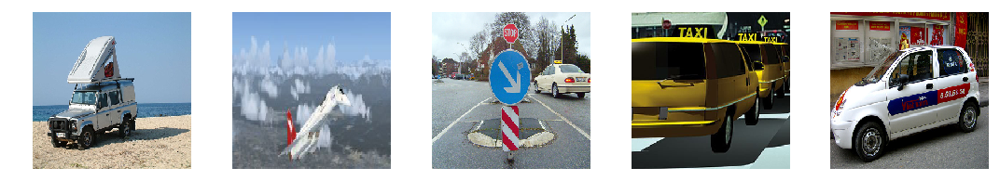

Last from Inception:
1681 1.0 484.48782 -0.0003540061116218567
958 1.0 431.94498 -0.00019083327054977416
172 -1.0 483.19482 -0.0001801341474056244
1167 1.0 442.78595 -0.00012412247061729432
783 1.0 448.62277 -0.00011606264114379883


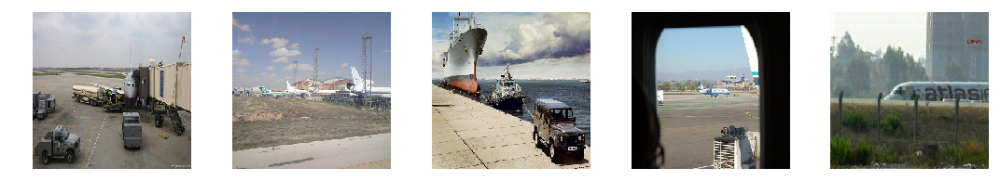

The test index now is 26. 
Test image:
-1.0 0.77615404 0.9987105131149292


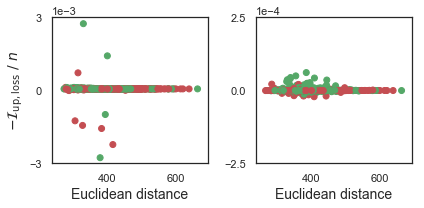

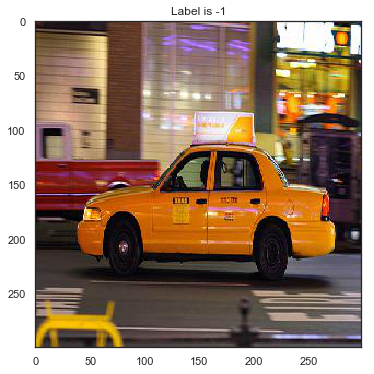

Top from Inception:
1072 -1.0 338.47586 3.9437856525182725e-05
887 -1.0 409.43774 4.2249172925949095e-05
871 -1.0 339.38547 4.3940469622612e-05
1995 -1.0 354.76636 4.95482049882412e-05
39 -1.0 385.51596 6.093882769346237e-05


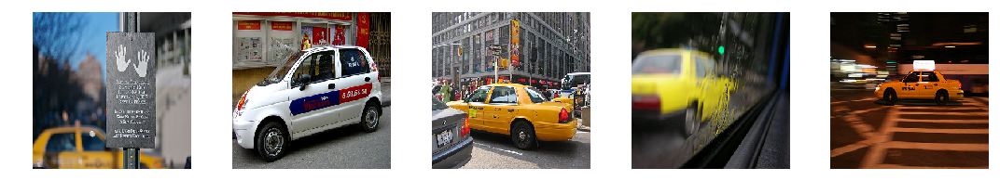

Last from Inception:
1167 1.0 408.53372 -2.181031182408333e-05
902 1.0 443.57745 -1.948424056172371e-05
852 1.0 377.58008 -1.943385414779186e-05
1632 1.0 349.39224 -1.828331872820854e-05
481 1.0 392.0472 -1.5365105122327804e-05


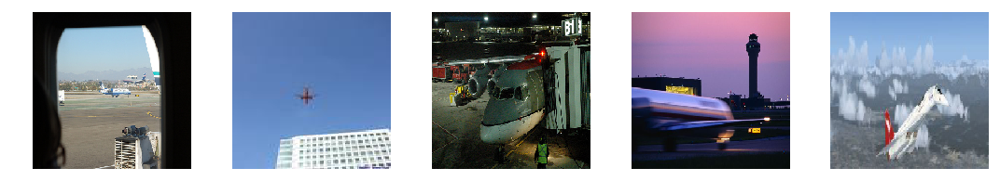

The test index now is 27. 
Test image:
-1.0 0.7619401 0.9989978671073914


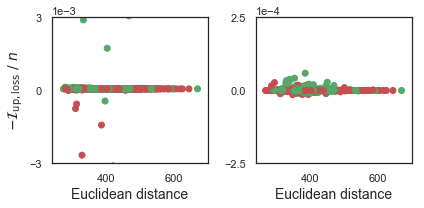

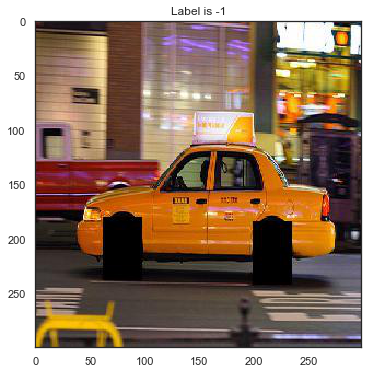

Top from Inception:
662 -1.0 330.56482 3.341345489025116e-05
871 -1.0 342.066 3.511654213070869e-05
1072 -1.0 339.84662 3.796008974313736e-05
1995 -1.0 354.44815 4.183229058980942e-05
39 -1.0 385.93094 5.871446430683136e-05


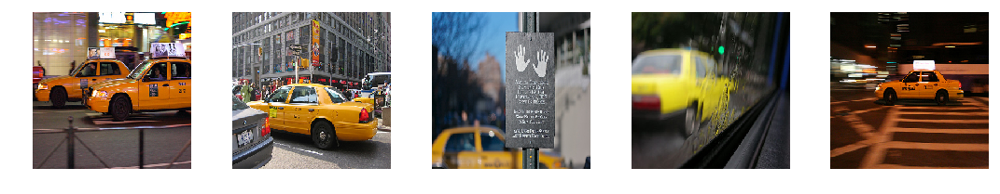

Last from Inception:
1632 1.0 349.00967 -1.4926176518201829e-05
852 1.0 377.3156 -1.4362303540110589e-05
481 1.0 394.71777 -1.405530609190464e-05
1444 1.0 312.85385 -1.1766106821596623e-05
902 1.0 446.9896 -1.102370023727417e-05


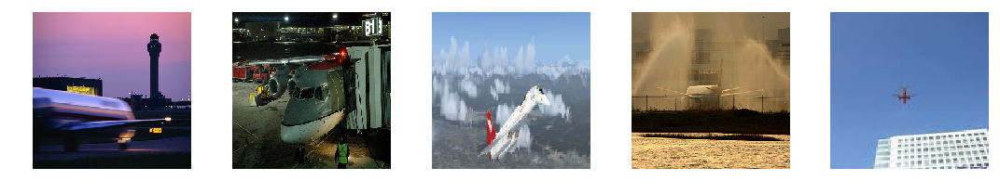

The test index now is 28. 
Test image:
-1.0 0.82652724 0.9990972280502319


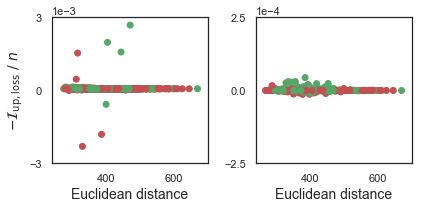

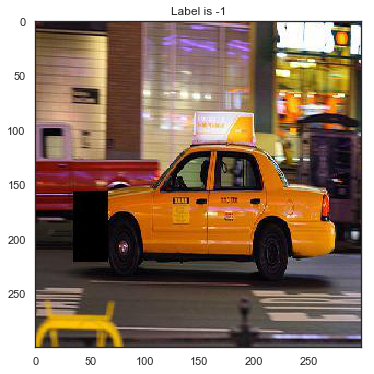

Top from Inception:
662 -1.0 327.4349 2.561325766146183e-05
871 -1.0 343.65298 2.8359543532133104e-05
1072 -1.0 333.89874 2.9797594994306563e-05
1995 -1.0 355.32407 2.998923510313034e-05
39 -1.0 384.28342 4.372711479663849e-05


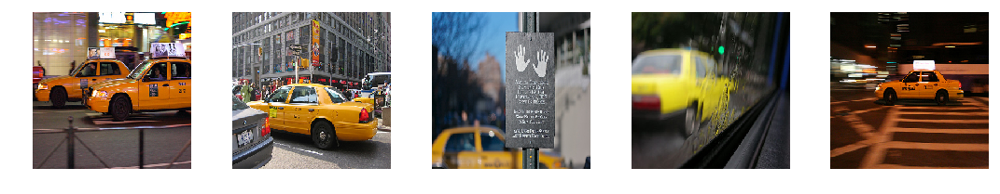

Last from Inception:
852 1.0 376.79266 -1.3640273362398147e-05
481 1.0 397.2816 -1.3167941942811012e-05
1632 1.0 349.95358 -1.2639235705137253e-05
902 1.0 445.68552 -1.0786386206746101e-05
1375 -1.0 400.54932 -9.958267211914063e-06


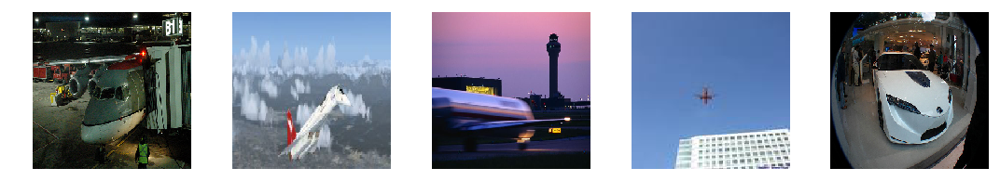

The test index now is 29. 
Test image:
-1.0 0.79126745 0.9991292357444763


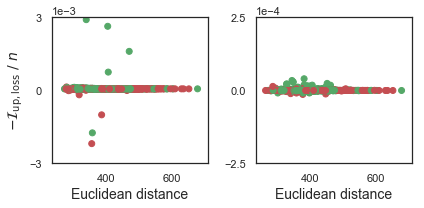

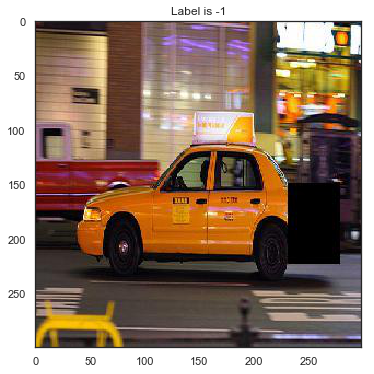

Top from Inception:
1508 -1.0 452.7421 2.3824743926525116e-05
871 -1.0 348.91025 2.7776595205068588e-05
1072 -1.0 349.33588 2.9147356748580933e-05
1995 -1.0 345.62372 3.381504118442536e-05
39 -1.0 382.5359 3.971762210130692e-05


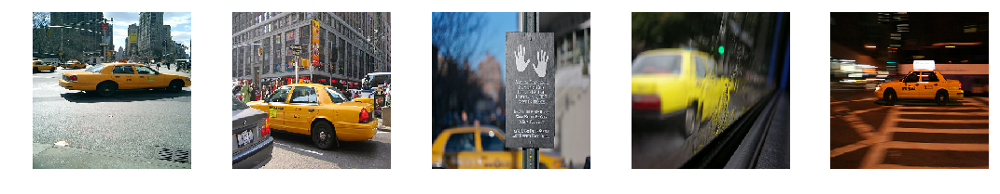

Last from Inception:
852 1.0 378.57907 -1.3980016112327576e-05
902 1.0 448.2389 -1.2454355135560036e-05
1632 1.0 341.5525 -1.1260434985160827e-05
1279 -1.0 379.3365 -9.214266203343869e-06
1666 1.0 359.1447 -9.147942997515202e-06


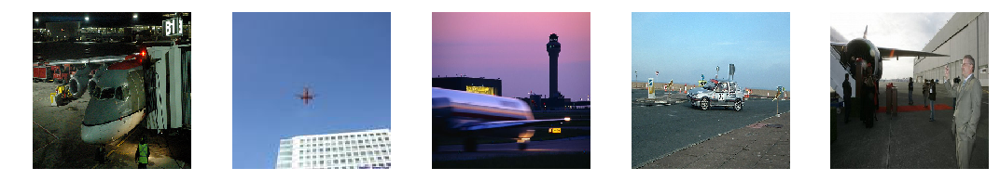

The test index now is 30. 
Test image:
-1.0 0.43888402 0.9993665814399719


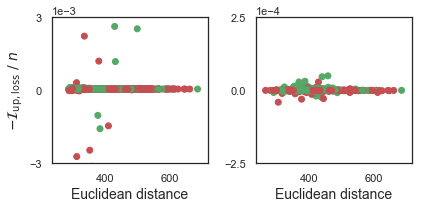

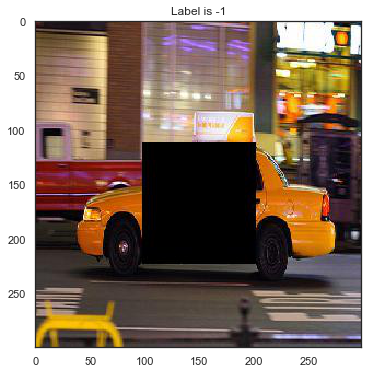

Top from Inception:
481 1.0 428.4459 2.8574027121067048e-05
1076 -1.0 367.98788 2.8712427243590355e-05
1907 -1.0 386.68466 3.117232024669647e-05
591 -1.0 439.65646 4.65879924595356e-05
557 -1.0 457.83453 4.9718618392944335e-05


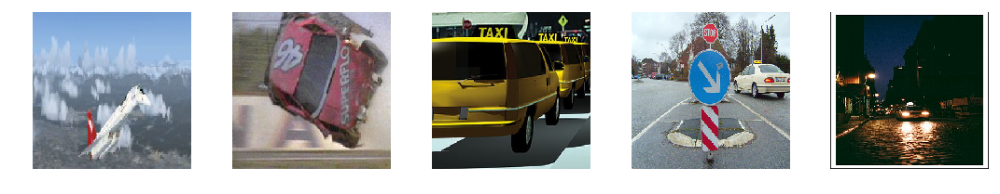

Last from Inception:
698 1.0 303.88058 -4.065737128257751e-05
1681 1.0 376.09802 -3.023622930049896e-05
1167 1.0 443.9136 -2.8546303510665894e-05
172 -1.0 436.67963 -2.265496924519539e-05
887 -1.0 421.1739 -1.9613686949014664e-05


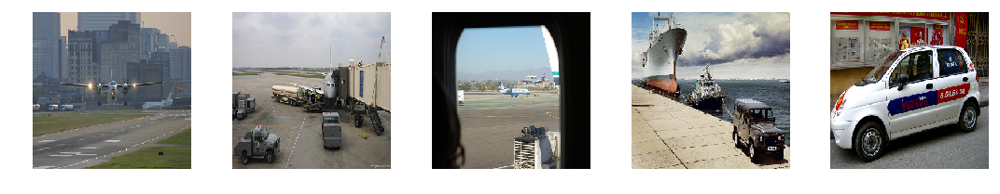

The test index now is 31. 
Test image:
-1.0 0.6917623 0.9947161078453064


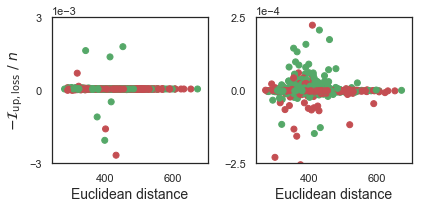

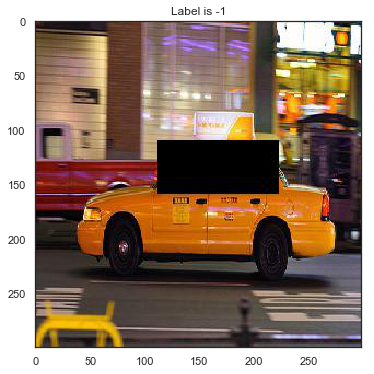

Top from Inception:
1072 -1.0 352.74475 0.00014446127414703369
1907 -1.0 389.42456 0.0001577272564172745
557 -1.0 459.99478 0.0001740153282880783
591 -1.0 429.7927 0.00020649534463882446
481 1.0 408.84427 0.00022339943051338196


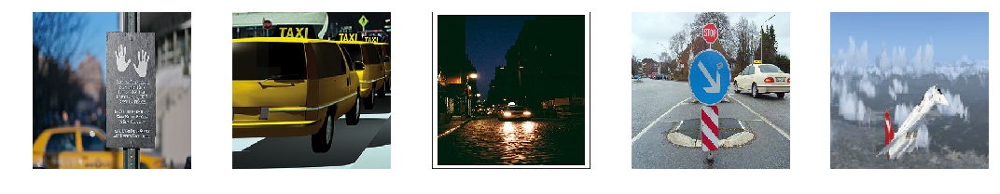

Last from Inception:
1681 1.0 373.42834 -0.00025481683015823365
698 1.0 297.0565 -0.00022955009341239929
1632 1.0 362.09335 -0.00015712916851043701
887 -1.0 414.69092 -0.00014793355762958527
783 1.0 353.69818 -0.00013279011845588684


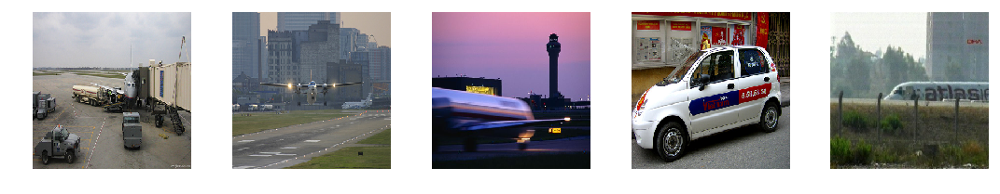

The test index now is 32. 
Test image:
-1.0 0.44787335 0.9999139308929443


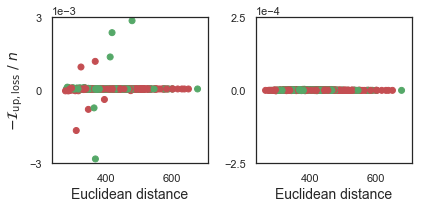

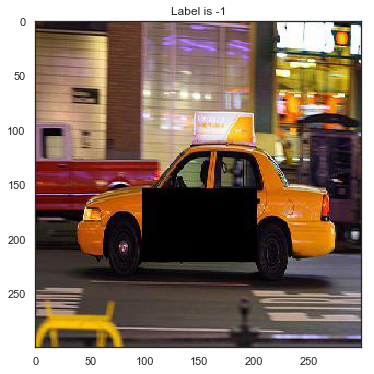

Top from Inception:
1072 -1.0 344.23233 2.7205641381442548e-06
1995 -1.0 366.32953 2.8747981414198877e-06
557 -1.0 463.48282 3.0012167990207674e-06
1321 -1.0 376.46045 3.3686677925288676e-06
39 -1.0 381.59784 3.7626675330102443e-06


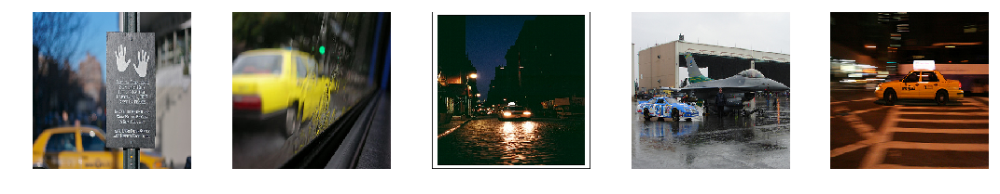

Last from Inception:
698 1.0 294.95554 -1.8969851080328225e-06
70 -1.0 383.83575 -1.3845297507941723e-06
1375 -1.0 419.08356 -1.2265131808817386e-06
1632 1.0 356.85965 -1.0245582088828088e-06
1428 1.0 327.1894 -9.739961824379862e-07


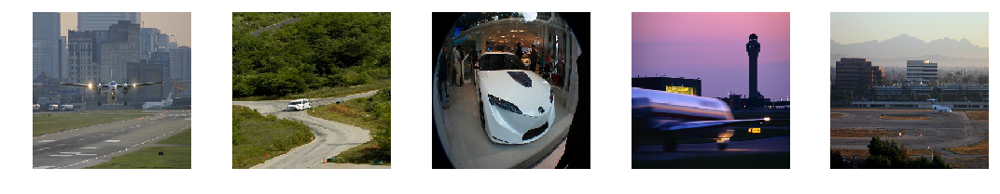

The test index now is 33. 
Test image:
-1.0 0.78778464 0.9996296167373657


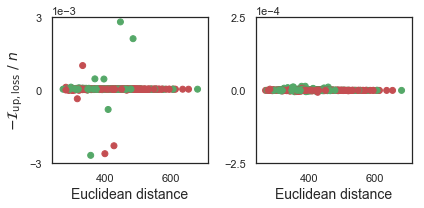

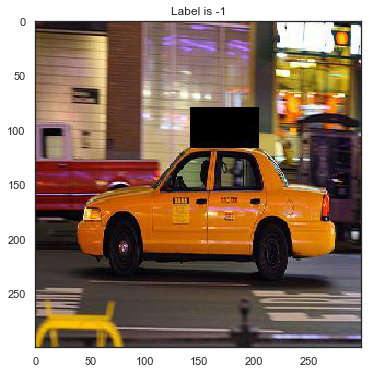

Top from Inception:
1995 -1.0 348.24265 1.083405502140522e-05
557 -1.0 456.8392 1.1279388330876827e-05
1072 -1.0 350.84454 1.1799342930316925e-05
1321 -1.0 375.8099 1.3876285403966904e-05
39 -1.0 387.03052 1.4059662818908692e-05


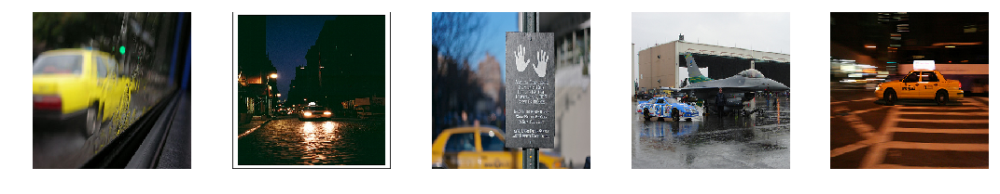

Last from Inception:
1167 1.0 424.86017 -6.680725142359733e-06
70 -1.0 354.33435 -4.7106607817113395e-06
1375 -1.0 389.02216 -4.565706476569176e-06
1632 1.0 359.5218 -4.15415083989501e-06
852 1.0 366.5532 -3.972704522311687e-06


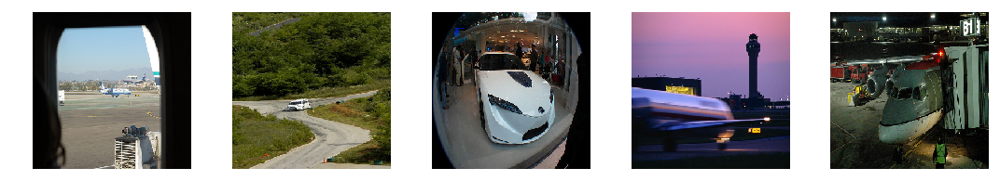

The test index now is 34. 
Test image:
1.0 2.5759153 0.9998888969421387


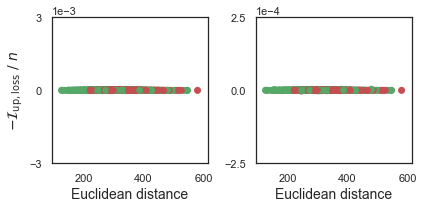

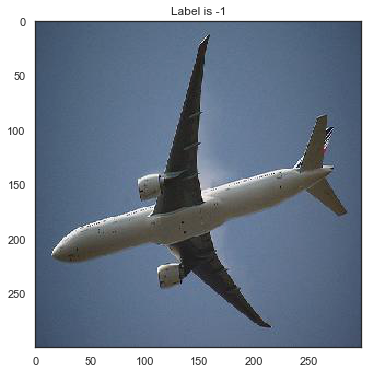

Top from Inception:
1116 1.0 311.46085 2.8551763389259575e-06
902 1.0 261.12888 3.3032558858394623e-06
481 1.0 281.33902 3.4770192578434942e-06
1853 1.0 379.43753 3.761041909456253e-06
1824 1.0 479.8086 3.929263912141323e-06


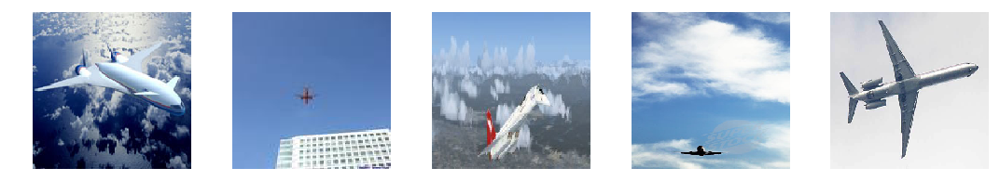

Last from Inception:
1076 -1.0 247.11488 -2.095197793096304e-06
1375 -1.0 307.3349 -1.5356622170656919e-06
1633 1.0 245.94865 -1.5354269417002798e-06
1167 1.0 331.1519 -1.5289760194718838e-06
1681 1.0 300.9476 -1.4777660835534335e-06


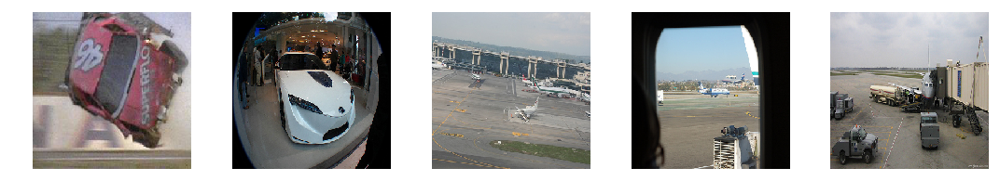

The test index now is 35. 
Test image:
1.0 0.63281775 0.9980337023735046


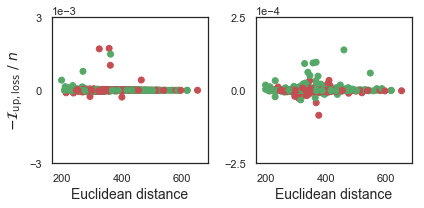

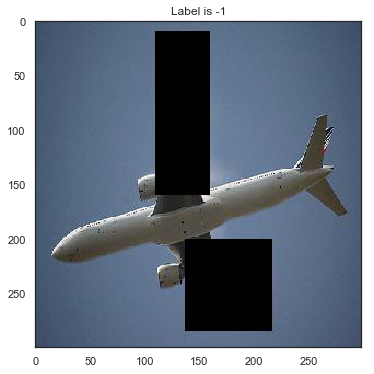

Top from Inception:
1632 1.0 340.38272 6.210575625300407e-05
167 1.0 329.46884 9.188887476921082e-05
481 1.0 357.652 9.394045174121857e-05
1116 1.0 367.90134 9.646668285131455e-05
1853 1.0 460.79184 0.00013859349489212037


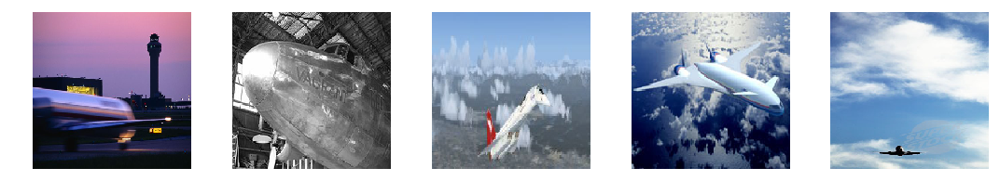

Last from Inception:
1321 -1.0 376.79224 -8.53230208158493e-05
591 -1.0 368.0745 -4.2445819824934005e-05
1633 1.0 316.60666 -3.2614491879940035e-05
1072 -1.0 310.0188 -2.7327347546815872e-05
1681 1.0 364.88602 -2.5148702785372734e-05


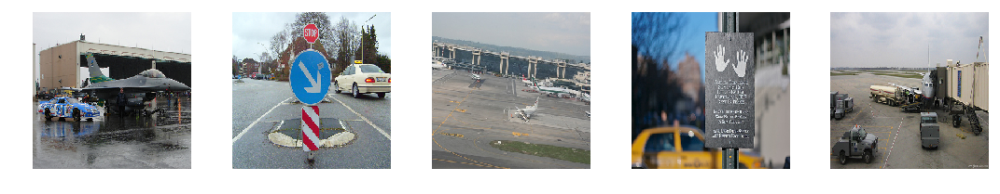

The test index now is 36. 
Test image:
1.0 1.7829818 0.9998953342437744


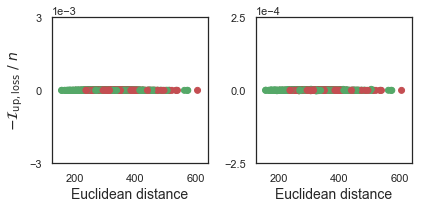

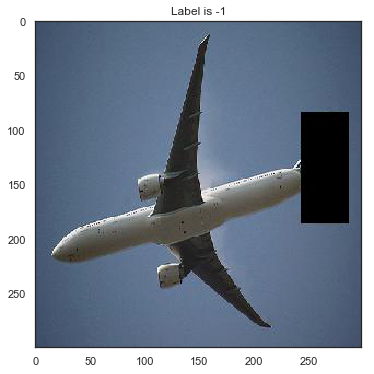

Top from Inception:
172 -1.0 350.30698 2.5227039586752654e-06
902 1.0 284.14804 3.0471826903522013e-06
1853 1.0 413.12936 3.3511808142066e-06
1824 1.0 505.17316 3.477173624560237e-06
481 1.0 306.94064 3.632553154602647e-06


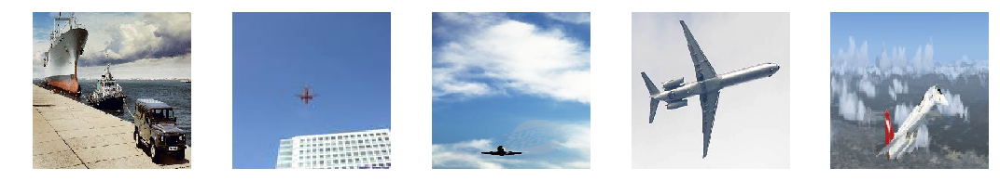

Last from Inception:
1681 1.0 324.31287 -2.154141664505005e-06
1633 1.0 267.44983 -1.287972554564476e-06
1076 -1.0 267.3298 -1.2811130145564675e-06
75 1.0 194.60263 -1.2564703356474638e-06
1375 -1.0 306.22092 -1.097829081118107e-06


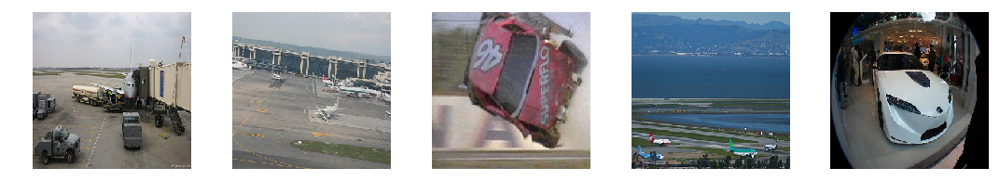

The test index now is 37. 
Test image:
1.0 2.1585877 0.9995402097702026


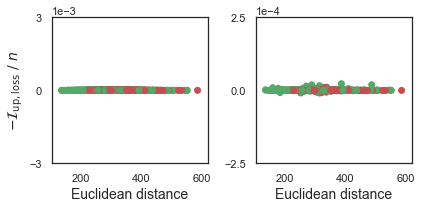

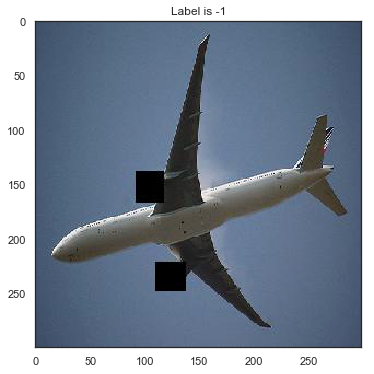

Top from Inception:
902 1.0 271.51886 1.4353530481457711e-05
1116 1.0 315.3179 1.60430446267128e-05
481 1.0 289.24353 1.8955757841467857e-05
1824 1.0 487.2101 1.9218211993575097e-05
1853 1.0 387.1815 2.2611595690250396e-05


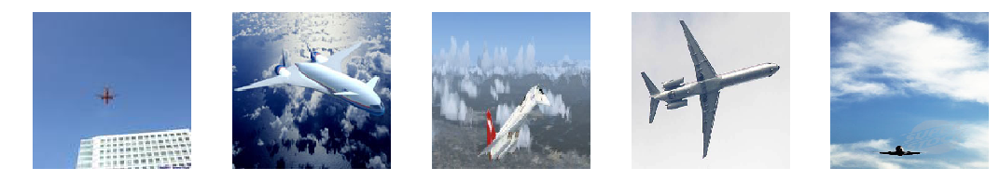

Last from Inception:
1375 -1.0 315.71112 -9.196499362587928e-06
1076 -1.0 253.38487 -8.463451638817787e-06
1633 1.0 254.0378 -8.022412657737732e-06
75 1.0 185.24725 -7.755867205560208e-06
1681 1.0 308.64163 -7.504153996706009e-06


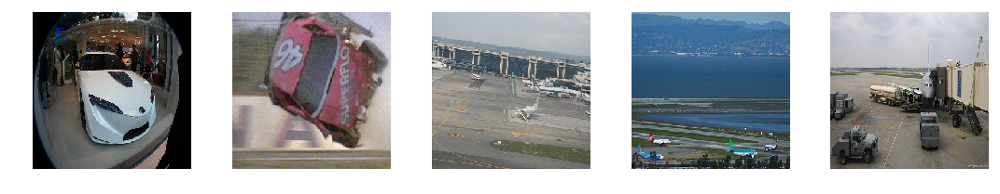

The test index now is 38. 
Test image:
1.0 2.1674848 0.9996975660324097


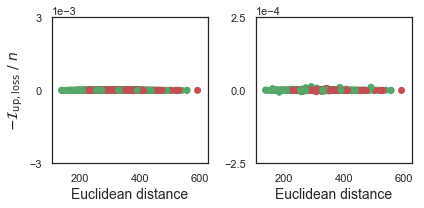

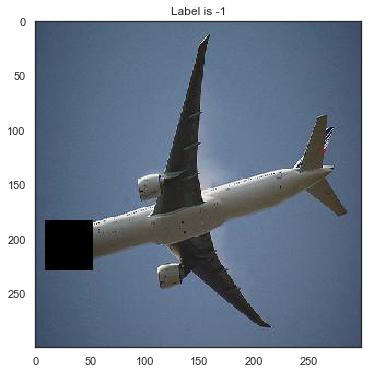

Top from Inception:
1116 1.0 310.4617 7.783194072544574e-06
902 1.0 273.97104 9.018022567033768e-06
1853 1.0 387.34106 1.000481192022562e-05
1824 1.0 491.15094 1.066632568836212e-05
481 1.0 292.52075 1.2903254479169845e-05


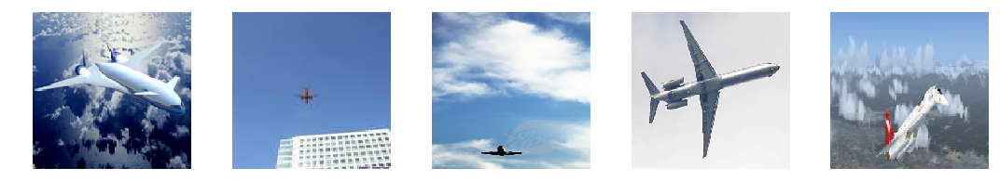

Last from Inception:
75 1.0 185.82468 -6.477543618530035e-06
1375 -1.0 309.43735 -4.895680118352175e-06
1633 1.0 258.65167 -4.885159432888031e-06
1076 -1.0 261.6689 -4.145643208175897e-06
591 -1.0 328.884 -3.523967694491148e-06


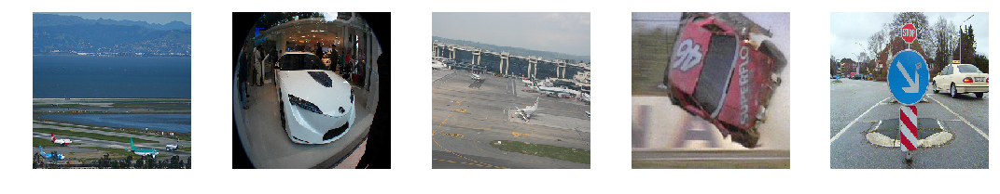

The test index now is 39. 
Test image:
1.0 2.1413138 0.9987704157829285


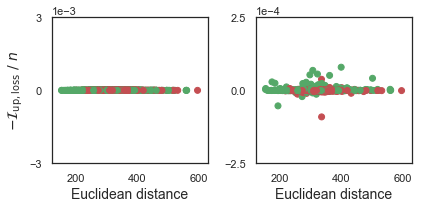

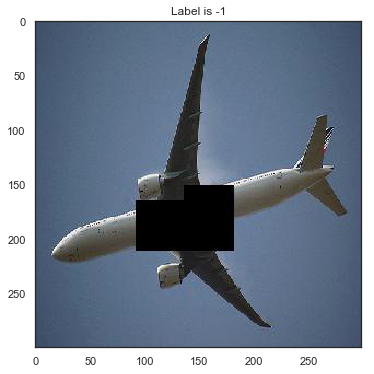

Top from Inception:
500 1.0 361.5572 5.12385293841362e-05
167 1.0 297.81046 5.313380807638168e-05
1116 1.0 322.29642 5.586268380284309e-05
481 1.0 307.20984 6.852501630783082e-05
1853 1.0 399.00925 7.931546121835708e-05


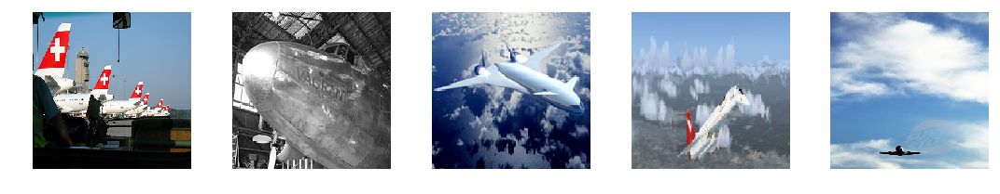

Last from Inception:
1321 -1.0 335.6857 -9.096762537956238e-05
75 1.0 194.5524 -5.3166404366493224e-05
1633 1.0 272.7027 -2.144966647028923e-05
644 1.0 318.69785 -1.3279669918119907e-05
1076 -1.0 258.00378 -1.3087648898363113e-05


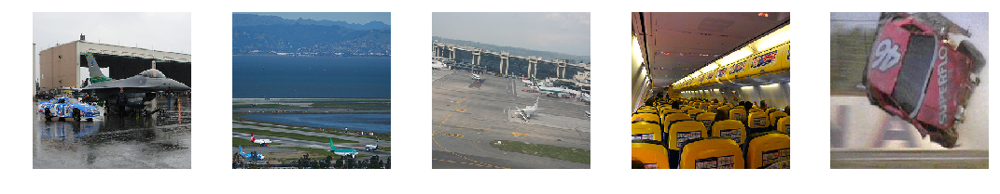

In [4]:
for i in range(40):
    f = np.load('output20/cover_testset_carair_results_%s.npz' % i)
    test_idx = f['test_idx']
    inception_Y_pred_correct = f['inception_Y_pred_correct']
    
    #if inception_Y_pred_correct[test_idx] < 0.5:
    #count += 1
    distances = f['distances']
    flipped_idx = f['flipped_idx']
    rbf_margins_test = f['rbf_margins_test']
    rbf_margins_train = f['rbf_margins_train']        
    rbf_predicted_loss_diffs = f['rbf_predicted_loss_diffs']
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']

    print('The test index now is %s. ' % i)
    sns.set_style('white')
    fontsize=14

    fig, axs = plt.subplots(1, 2, sharex=True, sharey=False, figsize=(6, 3))

    num_train = len(flipped_idx)
    color_vec = np.array(['g'] * num_train)
    color_vec[flipped_idx] = 'r'
    color_vec = list(color_vec)

    axs[0].scatter(distances, rbf_predicted_loss_diffs, color=color_vec)
    axs[0].set_ylim(-0.003, 0.003)
    axs[0].set_yticks((-0.003, 0, 0.003))
    axs[0].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[0].set_xlabel('Euclidean distance', fontsize=fontsize)
    axs[0].set_ylabel('$-\mathcal{I}_\mathrm{up, loss} \ /\ n$', fontsize=fontsize)

    axs[1].scatter(distances, inception_predicted_loss_diffs, color=color_vec)
    axs[1].set_ylim(-0.00025, 0.00025)
    axs[1].set_yticks((-0.00025, 0, 0.00025))
    axs[1].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[1].set_xlabel('Euclidean distance', fontsize=fontsize)

    plt.tight_layout()

    print('Test image:')
    print(Y_test[test_idx], rbf_margins_test[test_idx], inception_Y_pred_correct[test_idx])
    plot_flat_colorimage((X_test[test_idx, :] + 1) / 2, 0, side=299)

#         print('Top from RBF:')
#         fig, axs = plt.subplots(1, 5, figsize=(15,3))
#         for counter, train_idx in enumerate(np.argsort(rbf_predicted_loss_diffs)[-5:]):
#             print(train_idx, Y_train[train_idx], distances[train_idx], rbf_margins_train[train_idx], rbf_predicted_loss_diffs[train_idx])
#             x_train = X_train[train_idx, :]
#             axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
#             axs[counter].axis('off')
#         plt.tight_layout()
#         plt.show()

    print('Top from Inception:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.show()

    print('Last from Inception:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[:5]):
        print(train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.show()
        
#print('count=', count)

The test index now is 7. 
Test image:
1.0 1.3781374 0.9994304776191711
Top from Inception:
167 1.0 375.54538 1.8006253987550735e-05
1824 1.0 319.34677 1.9133877009153367e-05
1116 1.0 392.2001 2.50877533107996e-05
1853 1.0 240.25865 2.5719918310642242e-05
481 1.0 234.7025 3.07479053735733e-05


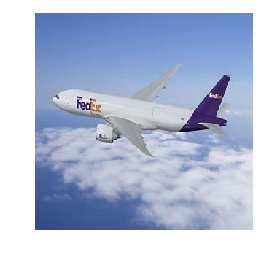

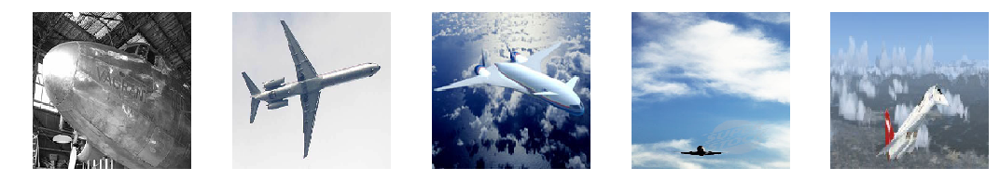

The test index now is 8. 
Test image:
1.0 0.9707123 0.9977703094482422
Top from Inception:
887 -1.0 450.90854 6.726662069559097e-05
1824 1.0 370.5825 7.316800951957702e-05
167 1.0 371.38757 9.839078783988953e-05
481 1.0 281.08167 0.00013208553194999696
1116 1.0 426.02005 0.0001347324252128601


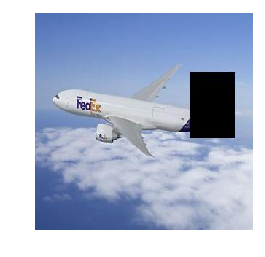

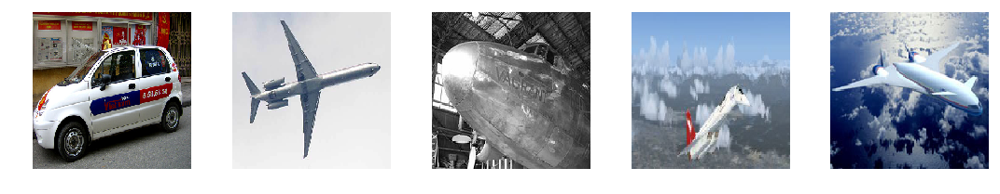

The test index now is 9. 
Test image:
1.0 0.8762091 0.9986248016357422
Top from Inception:
698 1.0 337.27496 6.0561265796422956e-05
1116 1.0 442.07288 7.147751748561859e-05
167 1.0 398.96036 8.308982849121094e-05
481 1.0 314.7081 8.588126301765442e-05
500 1.0 467.02917 9.659625589847565e-05


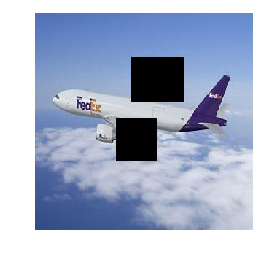

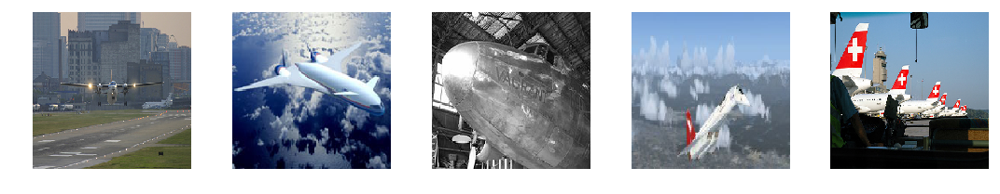

The test index now is 10. 
Test image:
1.0 1.2181357 0.9984312653541565
Top from Inception:
1824 1.0 324.6521 6.470530480146408e-05
1116 1.0 390.89163 6.774811446666717e-05
1853 1.0 252.27603 7.595640420913696e-05
167 1.0 382.6707 7.598941773176194e-05
481 1.0 240.67671 0.00011117354035377502


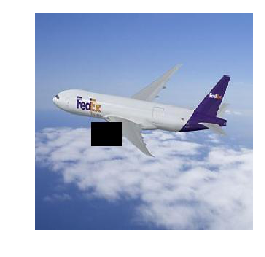

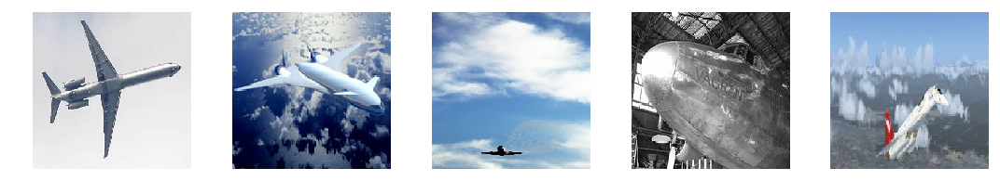

The test index now is 11. 
Test image:
1.0 1.1935043 0.9967814683914185
Top from Inception:
1116 1.0 399.16412 0.00011726431548595429
1824 1.0 351.222 0.0001187305748462677
500 1.0 445.76175 0.00013068175315856934
1853 1.0 279.0846 0.00016033799946308137
481 1.0 269.73358 0.0002599424719810486


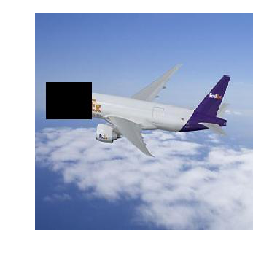

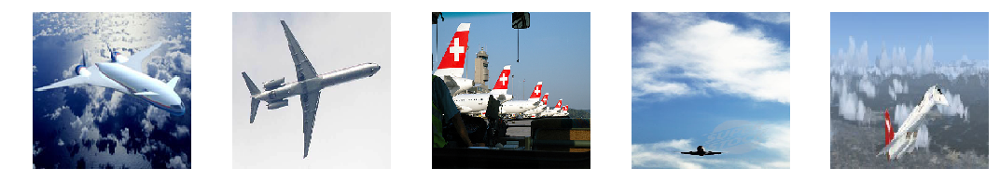

In [8]:
for i in range(7, 12):
    f = np.load('output20/cover_testset_carair_results_%s.npz' % i)
    test_idx = f['test_idx']
    inception_Y_pred_correct = f['inception_Y_pred_correct']
    
    #if inception_Y_pred_correct[test_idx] < 0.5:
    #count += 1
    distances = f['distances']
    flipped_idx = f['flipped_idx']
    rbf_margins_test = f['rbf_margins_test']
    rbf_margins_train = f['rbf_margins_train']        
    rbf_predicted_loss_diffs = f['rbf_predicted_loss_diffs']
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']

    print('The test index now is %s. ' % i)
    sns.set_style('white')
    fontsize=14

#     fig, axs = plt.subplots(1, 2, sharex=True, sharey=False, figsize=(6, 3))

#     num_train = len(flipped_idx)
#     color_vec = np.array(['g'] * num_train)
#     color_vec[flipped_idx] = 'r'
#     color_vec = list(color_vec)

#     axs[0].scatter(distances, rbf_predicted_loss_diffs, color=color_vec)
#     axs[0].set_ylim(-0.003, 0.003)
#     axs[0].set_yticks((-0.003, 0, 0.003))
#     axs[0].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
#     axs[0].set_xlabel('Euclidean distance', fontsize=fontsize)
#     axs[0].set_ylabel('$-\mathcal{I}_\mathrm{up, loss} \ /\ n$', fontsize=fontsize)

#     axs[1].scatter(distances, inception_predicted_loss_diffs, color=color_vec)
#     axs[1].set_ylim(-0.00025, 0.00025)
#     axs[1].set_yticks((-0.00025, 0, 0.00025))
#     axs[1].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
#     axs[1].set_xlabel('Euclidean distance', fontsize=fontsize)

#     plt.tight_layout()

    print('Test image:')
    print(Y_test[test_idx], rbf_margins_test[test_idx], inception_Y_pred_correct[test_idx])
    #plot_flat_colorimage((X_test[test_idx, :] + 1) / 2, 0, side=299)
    plt.axis('off')
    plt.imshow((np.reshape(X_test[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none', )
    plt.savefig('finish/cover_%s.jpg' % i, dpi=300, bbox_inches='tight')

#         print('Top from RBF:')
#         fig, axs = plt.subplots(1, 5, figsize=(15,3))
#         for counter, train_idx in enumerate(np.argsort(rbf_predicted_loss_diffs)[-5:]):
#             print(train_idx, Y_train[train_idx], distances[train_idx], rbf_margins_train[train_idx], rbf_predicted_loss_diffs[train_idx])
#             x_train = X_train[train_idx, :]
#             axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
#             axs[counter].axis('off')
#         plt.tight_layout()
#         plt.show()

    print('Top from Inception:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.savefig('finish/cover_%s_top_inception.jpg' % i, dpi=300, bbox_inches='tight')
    plt.show()